# Projet BioInfo : ALS

Réalisé par :  ETTAYEB Nour , GOUESSE Cassiopée ,  ELOUADI Firdaous

Objectif : Trouver les gènes associés à la maladie de charcot (ALS) par rapport au cas non malades. Ainsi, aider les professionnels de santé à diagnositquer cette maladies et surtout à créer un traitement efficace.

On dispose de 177 fichiers dont 176 contiennent le count par gène par échantillon et 1 fichier qui décrit les informations liée à chaque échantillon.  

In [1]:
# importation des bibliothèques python
import pandas as pd
import glob
import re
import xml.etree.ElementTree as et

## Etape 1 Prétraitement des données

On commence par extraire les données dans deux tables différentes.   
Nous avons fait le choix de ne pas combiner ces deux tables  

Remarque : 
Concernant les échantillons nous avons sélectionnées les données utiles pour notre projet tel que :  

* l'identifiant de l'échantillon : pour pouvoir faire correspondre les données des deux tables   
* sa catégorie : trivialement nécessaire pour pouvoir distinguer les échantillons malades et non malades  
* la région de prélèvement : cela peut  influencer la répartion des gènes/ARN  
* l'identifiant de la personne : cela nous permettra d'identifier les patients qui ont plusieurs échantillons

In [2]:
path = "./Bioinfo_Project_2025/Data"  # Chemin vers les données
pdList = []  # Variable pour stocker temporairement tous les dataframes (un par fichier txt)
for fname in glob.glob(path + "/*.txt"):
    df = pd.read_table(fname)  # Place le fichier dans un dataframe
    sample_name = re.search("GSM\d+", fname).group()  # Recherche le nom de l'échantillon dans le nom du fichier
    df.rename(index=df["gene/TE"], inplace=True)  # Renomme l'index (=lignes) en utilisant la colonne contenant le nom du gène
    df.drop(columns=df.columns[0], axis=1, inplace=True)  # Supprime la première colonne contenant le nom du gène, inutile maintenant
    df.rename(columns={df.columns[0]: sample_name}, inplace=True)  # Renomme la colonne (il n'y a qu'une seule colonne à cette étape) en utilisant le nom de l'échantillon
    pdList.append(df)  # Ajoute le dataframe actuel à la liste
    data_matrix = pd.concat(pdList, axis=1)  # Concatène tous les dataframes en un seul dataframe
    data_matrix = data_matrix.transpose()  # Transpose le dataframe pour obtenir une forme plus standard (échantillons x variables)

In [3]:
data_annotation = pd.DataFrame(
        columns = ['Sample_id', 'Cns_subregion','sample_group','subject_id']) # initialisation of the dataframe
xtree = et.parse('./Bioinfo_Project_2025/Data/GSE124439_family.xml') # create a variable containing the xml in a tree shape
xroot = xtree.getroot() # get the root of the tree to start the exploration of the tree/xml
# for each element named "sample" that can be found from the root
for child in xroot.iter("{http://www.ncbi.nlm.nih.gov/geo/info/MINiML}Sample"):
    temp_sample_id = child.attrib['iid'] # the attribut of this node contains the sample id ()
    # for each element named "Characteristics" that can be found from the current sample
    for child2 in child.iter("{http://www.ncbi.nlm.nih.gov/geo/info/MINiML}Characteristics"):
        if(child2.attrib["tag"] == "cns subregion"):
            temp_cns_subregion = child2.text.replace('\n', '')
        if(child2.attrib["tag"] == "sample group"):
            temp_sample_group = child2.text.replace('\n', '')
        if(child2.attrib["tag"] == "subject id"):
            temp_subject_id = child2.text.replace('\n', '')
    temp_df = pd.DataFrame({'Sample_id': [temp_sample_id], 'Cns_subregion': [temp_cns_subregion],'sample_group':[temp_sample_group],'subject_id':[temp_subject_id]})
    data_annotation = pd.concat([data_annotation, temp_df],ignore_index=True)

In [4]:
data_annotation

,Sample_id,Cns_subregion,sample_group,subject_id
0,GSM3533230,Frontal Cortex,ALS Spectrum MND,NEUEL133AK6
1,GSM3533231,Frontal Cortex,ALS Spectrum MND,NEUYV496XLP
2,GSM3533232,Frontal Cortex,ALS Spectrum MND,NEUZU200WEQ
3,GSM3533233,Frontal Cortex,ALS Spectrum MND,NEUME287RK2
4,GSM3533234,Frontal Cortex,ALS Spectrum MND,NEUEC006FND
...,...,...,...,...
171,GSM3533401,Frontal Cortex,ALS Spectrum MND,NEUMY028JH4
172,GSM3533402,Frontal Cortex,ALS Spectrum MND,NEUXR145UBL
173,GSM3533403,Frontal Cortex,ALS Spectrum MND,NEUKN209FNW
174,GSM3533404,Frontal Cortex,ALS Spectrum MND,NEUUF289NRL


**Creation d'une classe pour acceder aux données**

In [5]:
class ALS_RNAseq:
    def __init__(self):
        self.__data_matrix = data_matrix
        self.__data_annotation = data_annotation
        
    # Getter methods
    def get_data_matrix(self):
        return self.__data_matrix
    
    def get_data_annotation(self):
        return self.__data_annotation
    
    # Setter methods with validation
    def set_data_matrix(self, data_matrix):
        if isinstance(data_matrix, pd.DataFrame):
            self.__data_matrix = data_matrix
        else:
            raise ValueError("Data matrix must be a pandas DataFrame")
    
    def set_annotations(self, annotations):
        if isinstance(annotations, pd.DataFrame):
            self.__annotations = annotations
        else:
            raise ValueError("Annotations must be a pandas DataFrame")
    
    # Methode pour filtrer les données selon un critère
    def subset_data(self, column, value):
        if self.__data_annotation is None or self.__data_matrix is None:
            raise ValueError("Data matrix and annotations must be loaded first")
        
        filtered_samples = self.__data_annotation[self.__data_annotation[column] == value]['Sample_id']
        return self.__data_matrix.loc[filtered_samples]
    
    # methode d'affichage
    def __str__(self):
        return f"ALS_RNAseq Object:\nData Matrix: {self.__data_matrix.shape if self.__data_matrix is not None else 'Not Loaded'}\nAnnotations: {self.__annotations.shape if self.__annotations is not None else 'Not Loaded'}"

In [6]:
als_tools = ALS_RNAseq() # Initialise l'instance de l'outil ALS_RNAseq

In [7]:
als_tools.get_data_annotation()  # Récupère le dataframe contenant les informations sur les échantillons

,Sample_id,Cns_subregion,sample_group,subject_id
0,GSM3533230,Frontal Cortex,ALS Spectrum MND,NEUEL133AK6
1,GSM3533231,Frontal Cortex,ALS Spectrum MND,NEUYV496XLP
2,GSM3533232,Frontal Cortex,ALS Spectrum MND,NEUZU200WEQ
3,GSM3533233,Frontal Cortex,ALS Spectrum MND,NEUME287RK2
4,GSM3533234,Frontal Cortex,ALS Spectrum MND,NEUEC006FND
...,...,...,...,...
171,GSM3533401,Frontal Cortex,ALS Spectrum MND,NEUMY028JH4
172,GSM3533402,Frontal Cortex,ALS Spectrum MND,NEUXR145UBL
173,GSM3533403,Frontal Cortex,ALS Spectrum MND,NEUKN209FNW
174,GSM3533404,Frontal Cortex,ALS Spectrum MND,NEUUF289NRL


In [8]:
als_tools.get_data_matrix()  # Récupère le dataframe contenant les données relatives aux gènes et au comptage des ARN pour chaque échantillon

,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2MP1,A3GALT2,A4GALT,A4GNT,...,X6B_LINE:CR1:LINE,X7A_LINE:CR1:LINE,X7B_LINE:CR1:LINE,X7C_LINE:CR1:LINE,X7D_LINE:CR1:LINE,X8_LINE:CR1:LINE,X9_LINE:L1:LINE,Zaphod2:hAT-Tip100:DNA,Zaphod3:hAT-Tip100:DNA,Zaphod:hAT-Tip100:DNA
GSM3533230,42,149,0,3327,101,78,4,0,67,0,...,986,2218,2096,1120,84,556,134,570,2045,2446
GSM3533231,25,107,2,1787,153,109,2,1,25,0,...,1216,2373,2001,1144,118,582,153,552,2057,2279
GSM3533232,20,95,0,1830,121,127,1,1,11,0,...,905,2018,1815,1011,84,571,126,479,1659,1778
GSM3533233,22,101,0,2131,142,143,5,1,36,0,...,935,2278,2032,1198,97,562,132,540,2032,2135
GSM3533234,22,102,0,1706,83,178,1,3,31,0,...,966,2295,1993,1152,96,582,124,539,1742,1939
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM3533401,23,113,0,2130,72,71,2,3,21,0,...,553,1243,1089,658,72,320,73,311,1102,1169
GSM3533402,134,300,0,6077,171,42,8,5,225,0,...,719,1988,1691,966,119,460,109,399,1619,1724
GSM3533403,64,290,0,4752,118,174,8,2,135,0,...,623,1466,1246,726,61,358,107,347,1284,1469
GSM3533404,124,332,0,3516,141,173,3,2,192,0,...,743,1846,1680,936,110,479,120,503,1646,1839


## Etape 2 Analyse descriptive

Une fois que nous avons extrait les données, nous passons à leur exploration/ visualisation

#### Description des échantillons

Dans un premier temps nous nous sommes intéressé au données qui concernent les échantillons.

In [9]:
df = als_tools.get_data_matrix() #on récupère la matrice des données

On commence par calculer la moyenne , la médiane et l'écart-type pour chaque échantillon

In [10]:
# on import les bibliothèques pour pouvoir calculer des statistique pour les échantillons puis les gènes
from statistics import mean,median,stdev
list_mean = [] #liste pour contenir les moyennes de chaque échantillon
list_id = [] #liste pour contenir les id de chaque échantillon
list_median = [] #liste pour contenir la médiane de chaque échantillon
list_std = [] #liste pour contenir l'écart type de chaque échantillon

#pour chaque échantillon (chaque ligne de la matrice)
for index, line in df.iterrows(): 
    list_mean.append(line.mean()) #on calcule sa moyenne et on la rajoute dans la liste
    list_median.append(line.median()) #on calcule sa médiane et on la rajoute dans la liste
    list_std.append(line.std()) # on calcule son écart type et on le rajoute dans la liste
    list_id.append(index) #on rajoute son id à la liste des ids
#on créé un dataframe avec toutes les informations que l'on vient de récupérer sur chaque échantillon
df_stats = pd.DataFrame(data={'Sample_id':list_id,'mean':list_mean,'median':list_median,'standard_deviation':list_std})
df_stats

,Sample_id,mean,median,standard_deviation
0,GSM3533230,1041.382378,92.0,7144.948717
1,GSM3533231,881.608503,65.0,6556.784539
2,GSM3533232,802.592132,58.0,5618.694081
3,GSM3533233,785.868615,65.0,6617.736421
4,GSM3533234,906.813525,61.0,6815.130467
...,...,...,...,...
171,GSM3533401,621.179187,51.0,3875.932581
172,GSM3533402,1412.596518,136.0,7679.231478
173,GSM3533403,1142.241288,101.0,5264.705168
174,GSM3533404,1435.251546,132.0,7032.337770


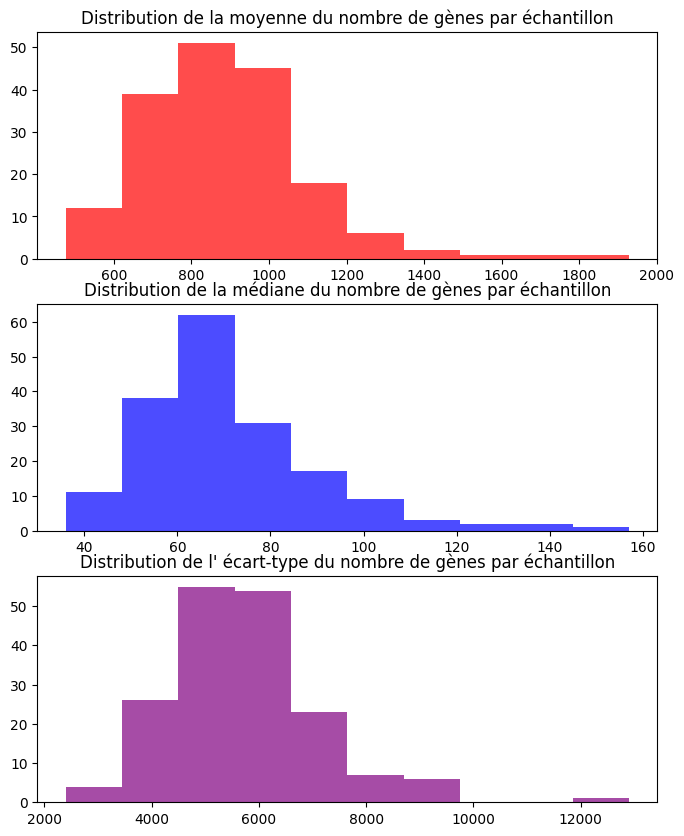

In [11]:
# Histogrammes pour représenter la distribution des moyennes, médianes et écarts-types calculés pour chaque échantillon. 
import matplotlib.pyplot as plt

# Création d'une figure avec un ensemble de sous-graphique pour pouvoir représenter les statistiques
fig, axs = plt.subplots(3, figsize=(8, 10))
# Création d'un histogramme pour les moyennes
axs[0].hist(df_stats['mean'], bins=10, alpha=0.7, color='red')
# Creation d'un histogramme pour les médianes
axs[1].hist(df_stats['median'], bins=10, alpha=0.7, color='blue')
# Creations d'un histogramme pour les écarts-types
axs[2].hist(df_stats['standard_deviation'], bins=10, alpha=0.7, color='purple')

# On rajoute les titres pour chaque graphique
axs[0].set_title('Distribution de la moyenne du nombre de gènes par échantillon')
axs[1].set_title('Distribution de la médiane du nombre de gènes par échantillon')
axs[2].set_title('Distribution de l\' écart-type du nombre de gènes par échantillon')

# On affiche les différents histogrammes
plt.show()

Interprétation de la distribution des métriques statistiques concernant :

1. La moyenne : 

On constate que le nombre de gène par échantillon est en moyenne compris entre 600 et 1200 . En revanche, on remarque qu'il y a quelques échantillons qui sorte du lot (les outliers) avec une nombre moyen de gène supérieur ou égal à 1400  

2. La médiane :

Les valeurs sont principalement comprises entre 40 et 100

3. L'écart-type : (à quel point les valeurs sont centrées autour de la moyenne)

Les valeurs sont principalement comprises entre 4000 et 8000


<u>Remarque générale</u> : 

La distribution des métriques statistiques suivent en moyenne une loi normale on a donc un certain équilibre.

Continuons notre exploration des données en mettant en lumière la distribution des echantillons en fonction de differents critères : 

In [12]:
df_annot = als_tools.get_data_annotation() # On récupère le dataframe des annotations
df_annot

,Sample_id,Cns_subregion,sample_group,subject_id
0,GSM3533230,Frontal Cortex,ALS Spectrum MND,NEUEL133AK6
1,GSM3533231,Frontal Cortex,ALS Spectrum MND,NEUYV496XLP
2,GSM3533232,Frontal Cortex,ALS Spectrum MND,NEUZU200WEQ
3,GSM3533233,Frontal Cortex,ALS Spectrum MND,NEUME287RK2
4,GSM3533234,Frontal Cortex,ALS Spectrum MND,NEUEC006FND
...,...,...,...,...
171,GSM3533401,Frontal Cortex,ALS Spectrum MND,NEUMY028JH4
172,GSM3533402,Frontal Cortex,ALS Spectrum MND,NEUXR145UBL
173,GSM3533403,Frontal Cortex,ALS Spectrum MND,NEUKN209FNW
174,GSM3533404,Frontal Cortex,ALS Spectrum MND,NEUUF289NRL


**On commence par explorer la distribution des échantillons en fonction du groupe**

In [13]:
#On calcul le nombre d'échantillons qu'il y a dans chaque groupe
df_disease = df_annot['sample_group'].value_counts().rename_axis('sample_group').reset_index(name='counts')
df_disease

,sample_group,counts
0,ALS Spectrum MND,145
1,Non-Neurological Control,17
2,Other Neurological Disorders,14


<u> Remarque </u>

Il y a un déséquilibre entre le groupe ALS et les groupes controle et autre maladies.  
Ce déséquilibre doit être pris en compte si on applique un modèle de machine learning pour minimiser les biais.

**Ensuite on s'interresse à la distribution des échantillons par rapport à sa source (Cns subregion) :**

In [14]:
# Répartition des échantillons en fonction de leur provenance
df_src = df_annot['Cns_subregion'].value_counts().rename_axis('Cns_subregion').reset_index(name='counts')
# Calcul du pourcentage pour mieux visualiser le résulat
df_src['percentage'] = ((df_src['counts'] / df_src['counts'].sum()) * 100).round(2)

df_src

,Cns_subregion,counts,percentage
0,Frontal Cortex,81,46.02
1,Motor Cortex (Medial),45,25.57
2,Motor Cortex (Lateral),45,25.57
3,Motor Cortex,5,2.84


<u> Remarque </u>

La région principale de la source de l'échantillon est le cortex frontal qui représente à peu près 46% des échantillons et la région minoritaire est le cortex moteur qui ne représente que 2.8% des échantillons environ. 

* Ensuite pour pouvoir réaliser des comparaisons cohérentes entre les échantillons, on a combiné les 2 explorations (groupe et source).

In [15]:
#on regarde donc pour chaque groupe d'où est-ce que l'échantillon provient

#pour le groupe ALS

#on récupère les échantillons du groupe ALS
df_sample_als = df_annot[df_annot['sample_group'] == 'ALS Spectrum MND      ']
df_sample_als.reset_index(drop=True, inplace=True) #on réinitialise les index pour plus de clarté

#on compte les occurences des sous-régions cérébrales pour le groupe ALS
count_als = df_sample_als['Cns_subregion'].value_counts().rename_axis('Cns_subregion').reset_index(name='counts')['counts']
#on ajoute ce résultat à notre dataframe global qui va regrouper les trois groupes en trois colonnes différentes
df_global_src = df_sample_als['Cns_subregion'].value_counts().rename_axis('Cns_subregion').reset_index(name='als')

In [16]:
#Pour le groupe 'Non-neurological control

#on récupère les échantillons de ce groupe
df_sample_control = df_annot[df_annot['sample_group'] == 'Non-Neurological Control      ']
df_sample_control.reset_index(drop=True, inplace=True) #on réinitialise les index pour plus de clarté

#on compte les occurences des sous-régions cérébrales pour ce groupe
# on ajoute le résultat pour ce groupe à notre dataframe global 
df_global_src['control'] = df_sample_control['Cns_subregion'].value_counts().rename_axis('Cns_subregion').reset_index(name='counts')['counts']

In [17]:
#Pour le groupe 'Other neurological'

#on récupère les échantillons de ce groupe
df_sample_other = df_annot[df_annot['sample_group'] == 'Other Neurological Disorders      ']
df_sample_other.reset_index(drop=True, inplace=True) #on réinitialise les index pour plus de clarté

#on compte les occurences des sous-régions cérébrales pour ce groupe
# on ajoute le résultat pour ce groupe à notre dataframe global 
df_global_src['other'] = df_sample_other['Cns_subregion'].value_counts().rename_axis('Cns_subregion').reset_index(name='counts')['counts']

**Ainsi on obtient une table qui représente la distribution des échantillon en fonction du groupe et de la région :**

In [18]:
#affichage de la table
df_global_src

,Cns_subregion,als,control,other
0,Frontal Cortex,65,9.0,7.0
1,Motor Cortex (Medial),38,4.0,4.0
2,Motor Cortex (Lateral),37,4.0,3.0
3,Motor Cortex,5,NaN,NaN


<u> Remarque </u>

* Groupe Frontal Cortex

Cette région représente pour chaque groupe la majorité des échantillons du groupe, à chaque fois environ 45% des échantillons proviennent de cette région.

* Groupe Motor Cortex (Medial et Lateral)

Ces deux régions sont représentées par la même proportion dans tous les groupes.

* Groupe Motor Cortex

Cette région est représentée uniquement dans le groupe ALS. En effet on a aucun échantillon qui provient de cette région pour les groupes non ALS. Les échantillons provenant de cette region ne peuvent donc être comparé par groupe. Cette absence d'échantillon de cette région dans les autres groupes est à prendre en compte dans l'analyse de nos résultats.

* Globale

On remarque que mis à part la région Groupe Motor Cortex, toutes les autres régions sont réparties de la même manière dans tous les groupes, avec une proportion de Groupe Motor Cortex (Medial et Lateral) à peut près égale dans chaque groupe tandis que la région principale de prélèvement reste le Cortex Frontal


**Combien de patients ont plusieurs échantillons :** 

In [20]:
# On récupère donc l'id du sujet de chaque échantillon pour voir si plusieurs échantillons ont le même
df_subject = df_annot['subject_id'].value_counts().rename_axis('subject_id').reset_index(name='counts')
df_subject.shape #nombre total de sujets (personnes) = 95

#on supprime les personnes étant associées à un unique échantillon pour ne regarder que celles qui en ont plusieurs
df_subject_copy = df_subject.drop(df_subject[df_subject['counts'] == 1].index)
df_subject_copy.shape #nombre de personnes ayant plusieurs échantillons  = 49

(49, 2)

**Création d'une dataframe résumant toutes les informations récupérées jusque là (utile pour le box-plot)**

In [21]:
#création de la dataframe en ajoutant les statistiques
data_info = als_tools.get_data_annotation().merge(df_stats).drop_duplicates(subset=['Sample_id'])

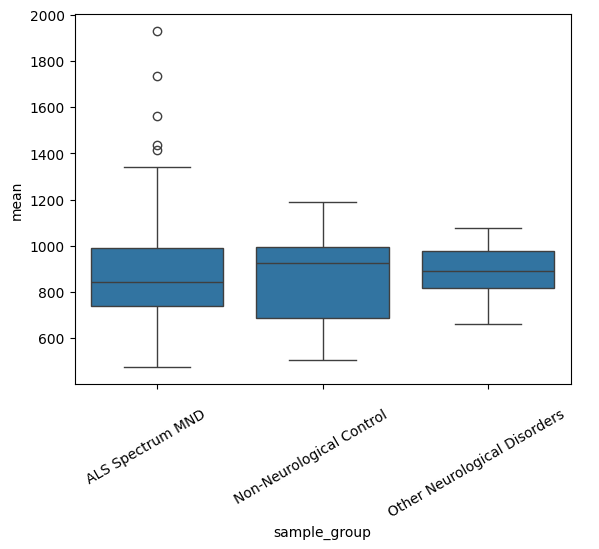

In [22]:
#création de box plot pour chaque groupe d'échantillon
import seaborn as sns
boxplot_data = data_info
#on met donc en abscisse les trois groupes différents et en ordonnée la moyenne
sns.boxplot(data=boxplot_data, x="sample_group", y="mean")
plt.xticks(rotation=30)
plt.show()

<u> Remarque </u>

On remarque que la moyenne du nombre de gène est proche par rapport aux 3 groupes d'échantillons. Les données qu'on dispose semblent être analysables pour le moment.

Cependant on constate des 5 outliers dans le groupe ALS, notons que si cette variabilité était liée à l'expérience alors on aurait dû aussi avoir des outliers en bas de la boite de moustache, car le bruit aurait une distribution normale. Mais ici ce n'est pas le cas, il est donc intéressant de marquer ces 5 outliers.

On choisit donc de rajouter une colonne dans notre dataframe global pour dire si un échantillon est un outlier ou non (on met 1 si il en est un et 0 sinon)

In [23]:
#on récupère les 5 échantillons que l'on observe sur la box plot, ceux ayant une moyenne très élevée
idx_outlier = data_info['mean'].nlargest(5).index

In [24]:
#rajout de la colonne désignant si un échantillon est un outlier ou non

#création de la liste colonne
list_idx = []

#pour tous les échantillons
for i in data_info.index : 
    if(i in idx_outlier): #si c'est un outlier
        list_idx.append(1) #alors on met 1 dans la colonne
    else : #sinon
        list_idx.append(0) #on met un 0

In [25]:
#rajout de la colonne dans le dataframe final
data_info['weird_mean'] = list_idx

### Encapsulation des visualisations dans une classe 


Pour structurer le projet de manière plus propre et réutilisable, toutes les fonctions liées à l’analyse descriptive et à la visualisation ont été regroupées dans la classe ALS_Visualizer.
Cela permet de centraliser les affichages graphiques et de faciliter leur appel ou leur mise à jour sans dupliquer le code.
L’ancienne version des visualisations est conservée à titre de référence, mais les nouvelles analyses peuvent désormais être appelées via des méthodes orientées-objet.

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os

class ALS_Visualizer:
    def __init__(self, data_matrix, data_annotation, output_dir="./figures"):
        # Initialisation de la classe avec la matrice de données et les annotations
        self.data_matrix = data_matrix  # Matrice d'expression génique 
        self.data_annotation = data_annotation  # Données d'annotation des échantillons 
        self.output_dir = output_dir  # Dossier où seront enregistrées les figures
        self.sample_stats = self._compute_sample_statistics()  # Calcul des statistiques descriptives pour chaque échantillon

        # Création du dossier de sortie s'il n'existe pas déjà
        if not os.path.exists(self.output_dir):
            os.makedirs(self.output_dir)

    def _compute_sample_statistics(self):
        """
        Calcule les statistiques de base (moyenne, médiane, écart-type)
        pour chaque échantillon dans la matrice de données.
        Retourne un DataFrame contenant ces valeurs.
        """
        means = self.data_matrix.mean(axis=1)  # Moyenne d'expression pour chaque échantillon
        medians = self.data_matrix.median(axis=1)  # Médiane d'expression
        stds = self.data_matrix.std(axis=1)  # Écart-type d'expression
        return pd.DataFrame({
            "Sample_id": self.data_matrix.index,  # Identifiants des échantillons (index de la matrice)
            "mean": means,  # Moyenne
            "median": medians,  # Médiane
            "standard_deviation": stds  # Écart-type
        })

    def plot_histograms(self, save=False):
        """
        Affiche les histogrammes des moyennes, médianes et écarts-types
        pour chaque échantillon afin de visualiser la dispersion des valeurs statistiques.
        Si save=True, sauvegarde la figure dans le dossier output_dir.
        """
        fig, axs = plt.subplots(3, figsize=(8, 10))  # Trois sous-graphes empilés verticalement

        # Histogramme des moyennes
        axs[0].hist(self.sample_stats['mean'], bins=10, alpha=0.7, color='red')
        axs[0].set_title('Distribution des moyennes')

        # Histogramme des médianes
        axs[1].hist(self.sample_stats['median'], bins=10, alpha=0.7, color='blue')
        axs[1].set_title('Distribution des médianes')

        # Histogramme des écarts-types
        axs[2].hist(self.sample_stats['standard_deviation'], bins=10, alpha=0.7, color='purple')
        axs[2].set_title('Distribution des écarts-types')

        plt.tight_layout()  # Améliore l'espacement des graphiques

        if save:
            # Sauvegarde de la figure si demandée
            plt.savefig(os.path.join(self.output_dir, "histograms.png"))
        plt.show()

    def plot_disease_group_bar(self, save=False):
        """
        Affiche un bar chart montrant la répartition des échantillons selon les groupes de maladies.
        Nettoie les noms de groupe au passage pour enlever les espaces inutiles.
        """
        df = self.data_annotation.copy()  # Copie locale pour éviter de modifier l'original
        df['sample_group'] = df['sample_group'].str.strip()  # Nettoyage des espaces
        group_counts = df['sample_group'].value_counts()  # Comptage des groupes

        # Affichage du bar chart
        ax = group_counts.plot(kind='bar', title='Répartition des groupes de maladies')
        plt.ylabel("Nombre d'échantillons")
        plt.xticks(rotation=30)  # Rotation des labels pour lisibilité

        if save:
            plt.savefig(os.path.join(self.output_dir, "disease_groups_bar.png"))
        plt.show()

    def plot_cns_region_bar(self, save=False):
        """
        Affiche un bar chart montrant la répartition des échantillons selon leur région cérébrale (Cns_subregion).
        """
        region_counts = self.data_annotation['Cns_subregion'].value_counts()  # Comptage des régions

        # Affichage du bar chart
        region_counts.plot(kind='bar', title='Répartition des sous-régions cérébrales')
        plt.ylabel("Nombre d'échantillons")
        plt.xticks(rotation=30)

        if save:
            plt.savefig(os.path.join(self.output_dir, "cns_regions_bar.png"))
        plt.show()

    def plot_boxplot_by_group(self, save=False):
        """
        Affiche un boxplot des moyennes d'expression génique par groupe de maladie.
        Permet de visualiser les différences de distributions entre les groupes.
        """
        merged = self.data_annotation.merge(self.sample_stats, on='Sample_id')  # Fusion des annotations et stats
        merged['sample_group'] = merged['sample_group'].str.strip()  # Nettoyage des noms de groupes

        sns.boxplot(data=merged, x='sample_group', y='mean')  # Boxplot avec seaborn
        plt.title("Distribution des moyennes par groupe")
        plt.xticks(rotation=30)

        if save:
            plt.savefig(os.path.join(self.output_dir, "boxplot_by_group.png"))
        plt.show()

    def plot_heatmap(self, nb_genes=50, save=False):
        """
        Affiche une heatmap des gènes les plus variables entre les échantillons.
        Cela permet de repérer visuellement les patterns d'expression les plus différenciants.
        """
        # Sélection des gènes ayant le plus grand écart-type (variabilité inter-échantillons)
        top_genes = self.data_matrix.std().sort_values(ascending=False).head(nb_genes).index

        # Affichage de la heatmap avec seaborn
        sns.heatmap(self.data_matrix[top_genes], cmap="viridis")
        plt.title(f"Heatmap des {nb_genes} gènes les plus variables")
        plt.xlabel("Gènes")
        plt.ylabel("Échantillons")

        if save:
            plt.savefig(os.path.join(self.output_dir, f"heatmap_top_{nb_genes}_genes.png"))
        plt.show()


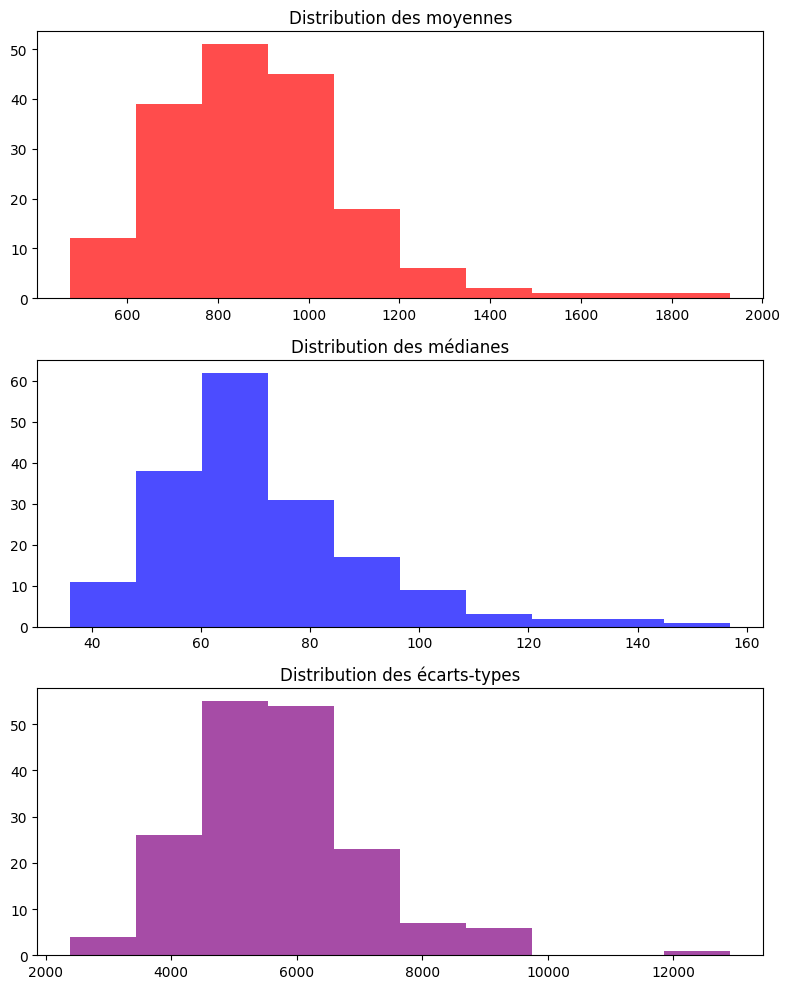

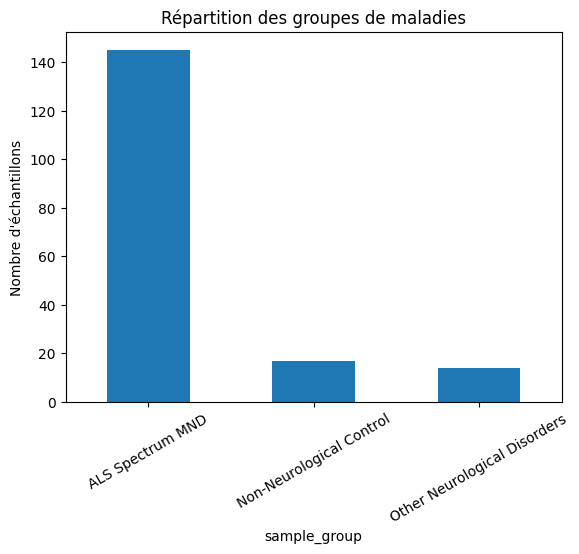

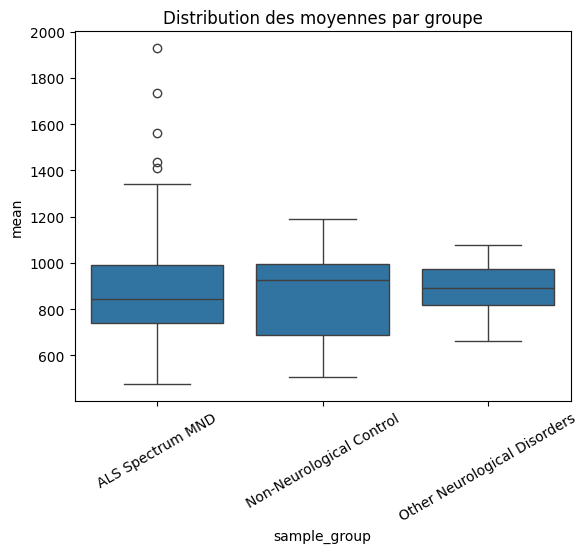

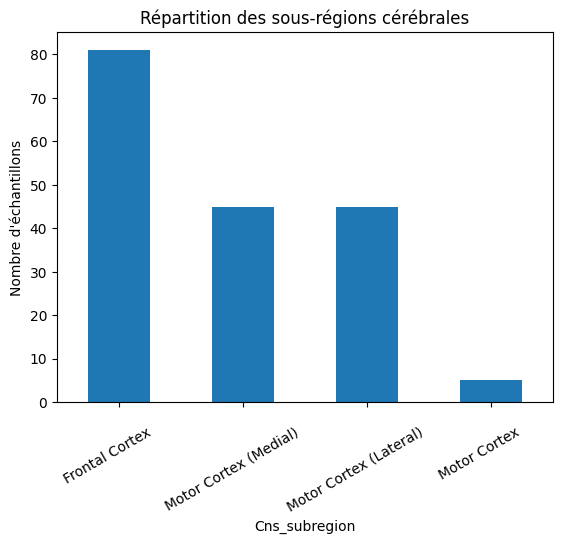

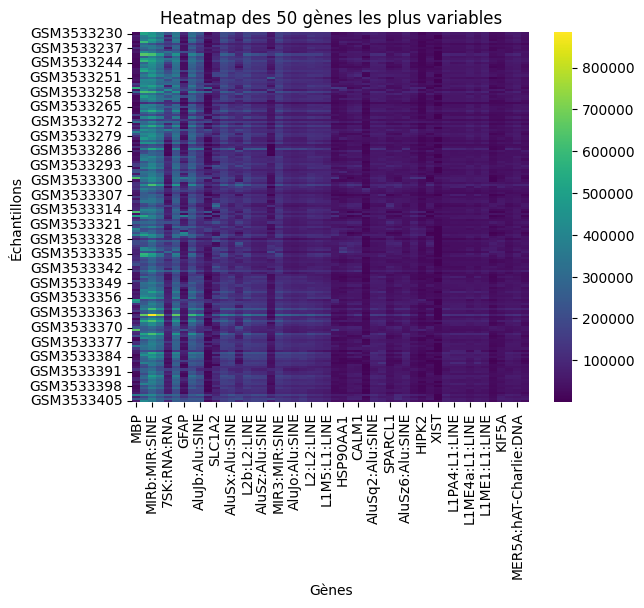

In [27]:
# Initialisation
als = ALS_RNAseq()
visual = ALS_Visualizer(als.get_data_matrix(), als.get_data_annotation())


visual.plot_histograms(save= True)
visual.plot_disease_group_bar(save= True)
visual.plot_boxplot_by_group(save= True)
visual.plot_cns_region_bar(save= True)
visual.plot_heatmap(save= True)

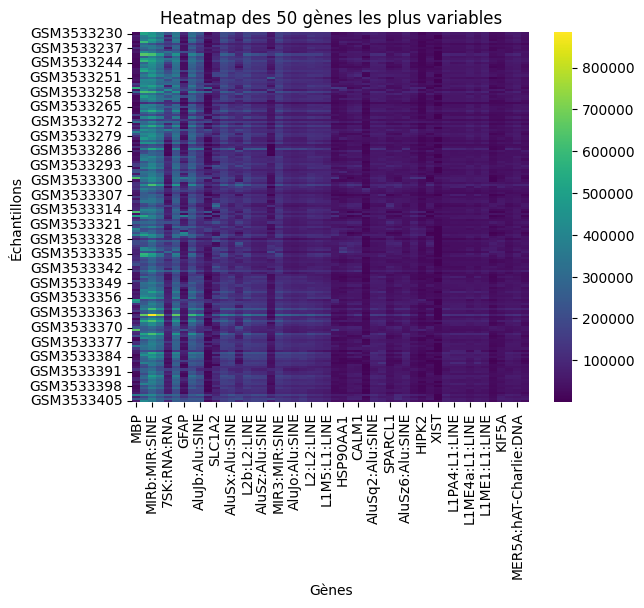

In [28]:
visual.plot_heatmap()

Cette heatmap représente les niveaux d'expression des 50 gènes les plus variables parmi l'ensemble des échantillons.
On observe une forte hétérogénéité dans l'expression de certains gènes, avec quelques pics d'expression marqués pour des échantillons spécifiques.
Cela pourrait refléter des différences biologiques entre les échantillons (ex : groupes de maladie, régions cérébrales), ou bien des variations techniques.
Ces gènes fortement variables mériteraient une exploration plus approfondie dans les étapes d’analyse différentielle.

#### Description du nombre d'ARN / gènes

**Dans un second temps on explore également les données du point vue des gènes**

##### Aperçu de l'expression des gènes

On commence par calculer les métriques statistiques pour chaque échantillon

In [29]:
#on récupère notre matrice de données sur laquelle on va travailler 
#cette fois-ci on va s'y intéresser colonne par colonne

df = als_tools.get_data_matrix()

#pour chaque gène on va donc calculer les statistiques, moyenne, médiane et écart type et mettre tout ça dans un dataframe
#création du dataframe 
df_stats_genes = pd.DataFrame({
    'gene': df.columns,  # le nom des gènes devient le titre des lignes du dataframe
    'mean': df.mean(axis=0),  # on calcule la moyenne pour chaque gène et on l'ajoute dans une colonne mean
    'median': df.median(axis=0),  # on calcule la médiane pour chaque gène et on l'ajoute dans une colonne median
    'standard_deviation': df.std(axis=0)  # on calcule l'écart type pour chaque gène et on l'ajoute dans une colonne stradart_deviation
}).reset_index(drop=True) #on réinitialise les index pour y voir plus clair

print(df_stats_genes.head()) #on affiche le début de la dataframe

       gene         mean  median  standard_deviation
0      A1BG    38.062500    34.0           20.511225
1  A1BG-AS1   118.568182   108.5           48.137849
2      A1CF     0.170455     0.0            0.662835
3       A2M  2455.403409  2286.5         1278.351971
4   A2M-AS1   102.568182    94.5           35.553998


On souhaite regarder maintenant dans chaque groupe les statistiques, on va donc trier les gènes en fonction du groupe puis ensuite regarder les statistiques par groupe :


In [30]:
#on supprime les espaces blancs qu'on trouve au début de chaque nom de groupe
df_annot['sample_group'] = df_annot['sample_group'].str.strip()

#on récupère toutes nos données pour en extraire que ce que l'on souhaite (trie des gènes par groupe)
#on créé une copie de la matrice de donnée
df_1 = als_tools.get_data_matrix().copy()
#on créé une copie des annotations avec l'index défini par les identifiants d'échantillons (Sample_id)
df_annot_idx = als_tools.get_data_annotation().copy().set_index(df_annot['Sample_id'].values)

#on regarde le groupe de chaque gène en ajoutant la colonne sample_group pour mieux identifier le groupe du gène
# Ajout de la colonne 'sample_group' à df_1 en utilisant les annotations d'échantillons basées sur 'Sample_id'
df_1['sample_group'] = df_annot_idx['sample_group']
df_1 = df_1.drop_duplicates() # Suppression des doublons dans df_1, afin de ne garder que les lignes uniques

#groupe ALS
# Création d'un sous-ensemble des données où le groupe est 'ALS Spectrum MND' et suppression de la colonne 'sample_group'
df_gene_als = df_1[df_1['sample_group']=='ALS Spectrum MND'].drop(columns=['sample_group'])

#groupe control
# Création d'un sous-ensemble des données où le groupe est 'Non-Neurological Control' et suppression de la colonne 'sample_group'
df_gene_control = df_1[df_1['sample_group']=='Non-Neurological Control'].drop(columns=['sample_group'])

#groupe other
# Création d'un sous-ensemble des données où le groupe est 'Other Neurological Disorders' et suppression de la colonne 'sample_group'
df_gene_other = df_1[df_1['sample_group'] == 'Other Neurological Disorders'].drop(columns=['sample_group'])

On a donc nos trois dataframe, un pour chaque groupe où se trouvent les gènes du groupe du dataframe

In [31]:
#on calcule les statistiques pour le groupe ALS que l'on met dans un dataframe
df_stats_als = pd.DataFrame({
    'gene': df_gene_als.columns, # le nom des gènes devient le titre des lignes du dataframe
    'mean_als': df_gene_als.mean(axis=0), #on calcule la moyenne pour chaque gène et on l'ajoute dans une colonne mean_als
    'median_als': df_gene_als.median(axis=0), #on calcule la médiane pour chaque gène et on l'ajoute dans une colonne median_als
    'std_als': df_gene_als.std(axis=0) #on calcule l'écart-type pour chaque gène et on l'ajoute dans une colonne std_als
}).reset_index(drop=True) #on réinitialise les index pour plus de clarté

#on calcule les statistiques pour le groupe control que l'on met dans un dataframe
df_stats_control = pd.DataFrame({
    'gene': df_gene_control.columns, # le nom des gènes devient le titre des lignes du dataframe
    'mean_control': df_gene_control.mean(axis=0), #on calcule la moyenne pour chaque gène et on l'ajoute dans une colonne mean_control
    'median_control': df_gene_control.median(axis=0), #on calcule la médiane pour chaque gène et on l'ajoute dans une colonne median_control
    'std_control': df_gene_control.std(axis=0) #on calcule l'écart-type pour chaque gène et on l'ajoute dans une colonne std_control
}).reset_index(drop=True) #on réinitialise les index pour plus de clarté

#on calcule les statistiques pour le groupe other que l'on met dans un dataframe
df_stats_other = pd.DataFrame({ 
    'gene': df_gene_other.columns, # le nom des gènes devient le titre des lignes du dataframe
    'mean_other_neuro': df_gene_other.mean(axis=0), #on calcule la moyenne pour chaque gène et on l'ajoute dans une colonne mean_other_neuro
    'median_other_neuro': df_gene_other.median(axis=0), #on calcule la médiane pour chaque gène et on l'ajoute dans une colonne median_other_neuro
    'std_other_neuro': df_gene_other.std(axis=0) #on calcule l'écart-type pour chaque gène et on l'ajoute dans une colonne std_other_neuro
}).reset_index(drop=True) #on réinitialise les index pour plus de clarté

In [32]:
#on affiche le début de la dataframe des statistiques du groupe als
df_stats_als.head()

,gene,mean_als,median_als,std_als
0,A1BG,37.710345,33.0,20.312803
1,A1BG-AS1,119.379310,109.0,51.383778
2,A1CF,0.200000,0.0,0.722649
3,A2M,2486.924138,2222.0,1338.114568
4,A2M-AS1,103.503448,95.0,35.813972


In [33]:
#on affiche le début de la dataframe des statistiques du groupe control
df_stats_control.head()

,gene,mean_control,median_control,std_control
0,A1BG,39.764706,34.0,24.605714
1,A1BG-AS1,122.705882,124.0,31.003558
2,A1CF,0.000000,0.0,0.000000
3,A2M,2609.941176,2560.0,975.340227
4,A2M-AS1,92.470588,88.0,32.950944


In [34]:
#on affiche le début de la dataframe des statistiques du groupe other
df_stats_other.head()

,gene,mean_other_neuro,median_other_neuro,std_other_neuro
0,A1BG,39.642857,39.0,18.437450
1,A1BG-AS1,105.142857,101.0,23.250665
2,A1CF,0.071429,0.0,0.267261
3,A2M,1941.285714,1890.0,816.736416
4,A2M-AS1,105.142857,103.0,36.363247


In [35]:
# on mets toutes ces statistiques dans un seul et même dataframe
df_gene_stats= df_stats_als.merge(df_stats_control, on='gene').merge(df_stats_other, on='gene')
#on affiche le début de ce dataframe
df_gene_stats.head()

,gene,mean_als,median_als,std_als,mean_control,median_control,std_control,mean_other_neuro,median_other_neuro,std_other_neuro
0,A1BG,37.710345,33.0,20.312803,39.764706,34.0,24.605714,39.642857,39.0,18.437450
1,A1BG-AS1,119.379310,109.0,51.383778,122.705882,124.0,31.003558,105.142857,101.0,23.250665
2,A1CF,0.200000,0.0,0.722649,0.000000,0.0,0.000000,0.071429,0.0,0.267261
3,A2M,2486.924138,2222.0,1338.114568,2609.941176,2560.0,975.340227,1941.285714,1890.0,816.736416
4,A2M-AS1,103.503448,95.0,35.813972,92.470588,88.0,32.950944,105.142857,103.0,36.363247


<u>Remarque</u>

Le fait de calculer pour chaque gène les métriques nous permet de savoir quel est le gène le plus présent dans tous les écahntillon en moyenne. En revanche, il y a énormément de gène les dataframes ne sont donc pas exploitable tel qu'elle.   

Pour cela, on transforme les données pour créer des reprensentation graphique

##### Transformation des données

In [36]:
import numpy as np
#on transforme nos données pour mieux les visualiser sur la heatmap
df_log_transformed = np.log2(df)
#on affiche ces données
df_log_transformed.head()

C:\Users\firda\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: divide by zero encountered in log2
  result = func(self.values, **kwargs)


,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2MP1,A3GALT2,A4GALT,A4GNT,...,X6B_LINE:CR1:LINE,X7A_LINE:CR1:LINE,X7B_LINE:CR1:LINE,X7C_LINE:CR1:LINE,X7D_LINE:CR1:LINE,X8_LINE:CR1:LINE,X9_LINE:L1:LINE,Zaphod2:hAT-Tip100:DNA,Zaphod3:hAT-Tip100:DNA,Zaphod:hAT-Tip100:DNA
GSM3533230,5.392317,7.219169,-inf,11.700006,6.658211,6.285402,2.000000,-inf,6.066089,-inf,...,9.945444,11.115044,11.033423,10.129283,6.392317,9.118941,7.066089,9.154818,10.997885,11.256209
GSM3533231,4.643856,6.741467,1.0,10.803324,7.257388,6.768184,1.000000,0.000000,4.643856,-inf,...,10.247928,11.212496,10.966505,10.159871,6.882643,9.184875,7.257388,9.108524,11.006326,11.154185
GSM3533232,4.321928,6.569856,-inf,10.837628,6.918863,6.988685,0.000000,0.000000,3.459432,-inf,...,9.821774,10.978710,10.825754,9.981567,6.392317,9.157347,6.977280,8.903882,10.696098,10.796040
GSM3533233,4.459432,6.658211,-inf,11.057315,7.149747,7.159871,2.321928,0.000000,5.169925,-inf,...,9.868823,11.153552,10.988685,10.226412,6.599913,9.134426,7.044394,9.076816,10.988685,11.060020
GSM3533234,4.459432,6.672425,-inf,10.736402,6.375039,7.475733,0.000000,1.584963,4.954196,-inf,...,9.915879,11.164278,10.960726,10.169925,6.584963,9.184875,6.954196,9.074141,10.766529,10.921097


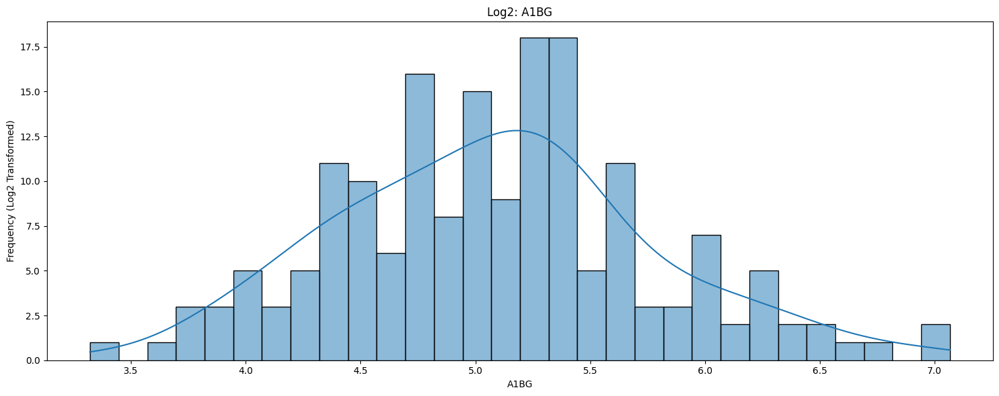

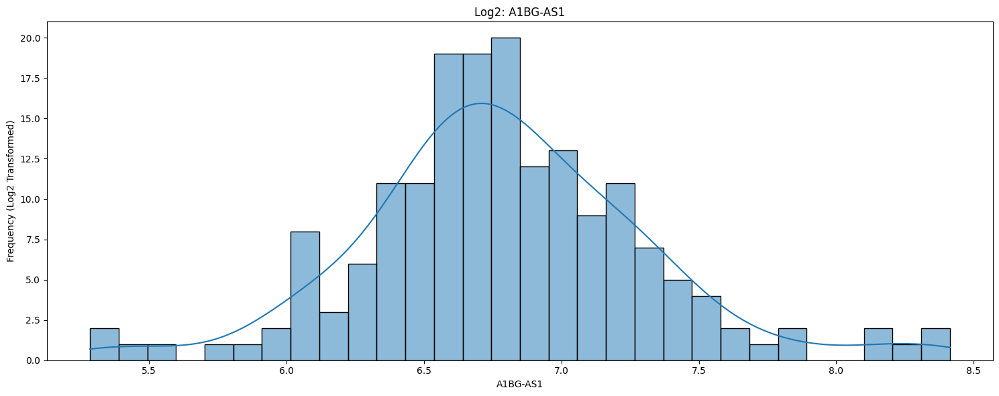

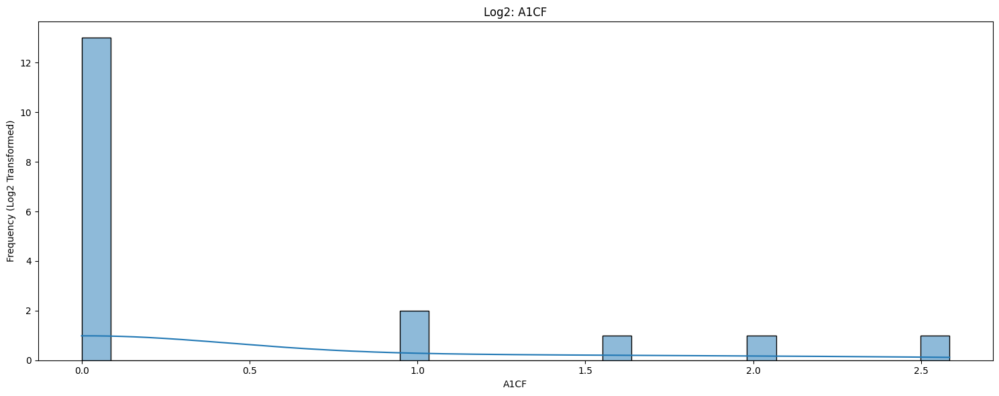

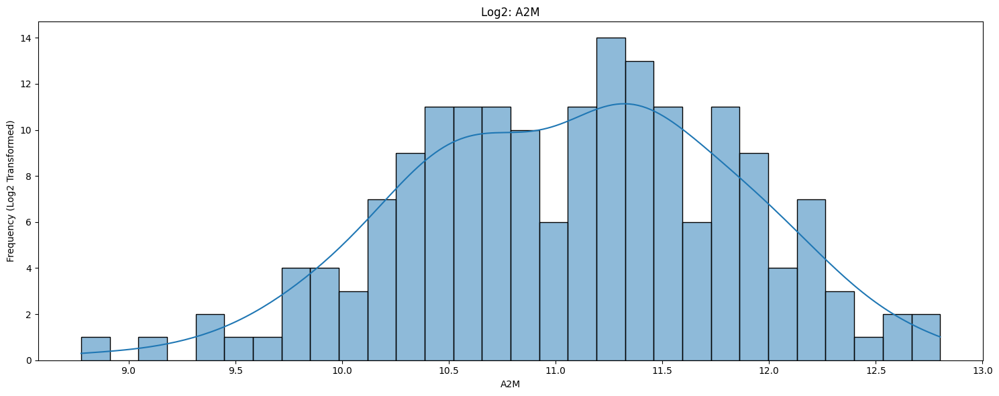

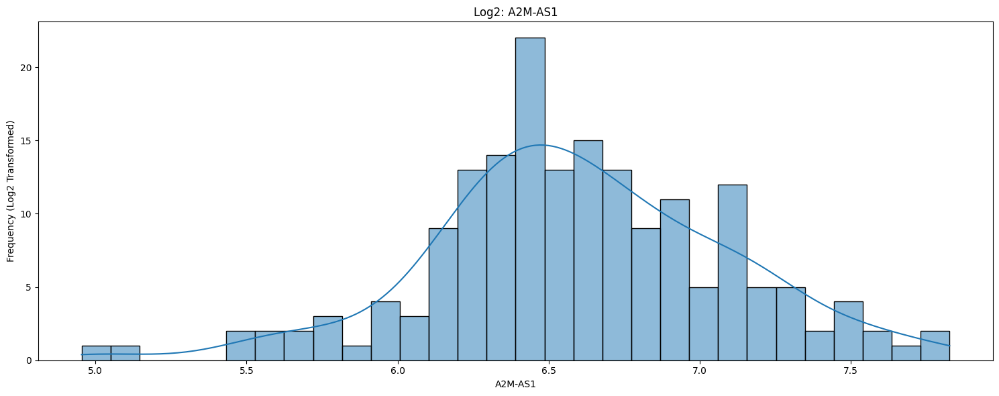

In [37]:
import matplotlib.pyplot as plt
# Tracer l'histogramme avant et après transformation pour quelques gènes
genes_to_plot = df.columns[:5]   # Sélectionner les 5 premiers gènes pour la visualisation

#pour tous les gènes que l'on a selectionné
for i, gene in enumerate(genes_to_plot):
    # Tracer après transformation logarithmique
    fig, axes = plt.subplots(figsize=(15, 6)) # Créer une figure avec des axes pour chaque gène
    sns.histplot(df_log_transformed[gene], bins=30, kde=True) # Tracer l'histogramme avec estimation de la densité (KDE) après transformation log2
    axes.set_title(f"Log2: {gene}") # Ajouter un titre avec le nom du gène et préciser que c'est après transformation log2

    axes.set_ylabel("Frequency (Log2 Transformed)") # Ajouter un label à l'axe des y pour indiquer que les données sont transformées log2
    plt.tight_layout()  # Ajuster les espacements pour que tout soit bien affiché
    plt.show() # Afficher l'histogramme

<u>Remarque</u>

Parmi les 5 gènes qu'on a représenté , on note qu'il y a 4 gène qui ont distribution normale , leur proportion est donc équilibrés entre les échantillons tout groupe confondu. 
Cependant, on note que le gène A1CF n'a pas une distribution uniforme, cela peut être utile dans notre analyse. 

Le fait de représenter la distribution des métriques statistiques pour chaque gène peut nous perttre d'identifier les outliers. Cependant, cela signifie qu'on devra analyser 28 000 graphique ce qui n'est pas optimal. 

**Représentation de la heatmap pour analyser les potentielles correlations**

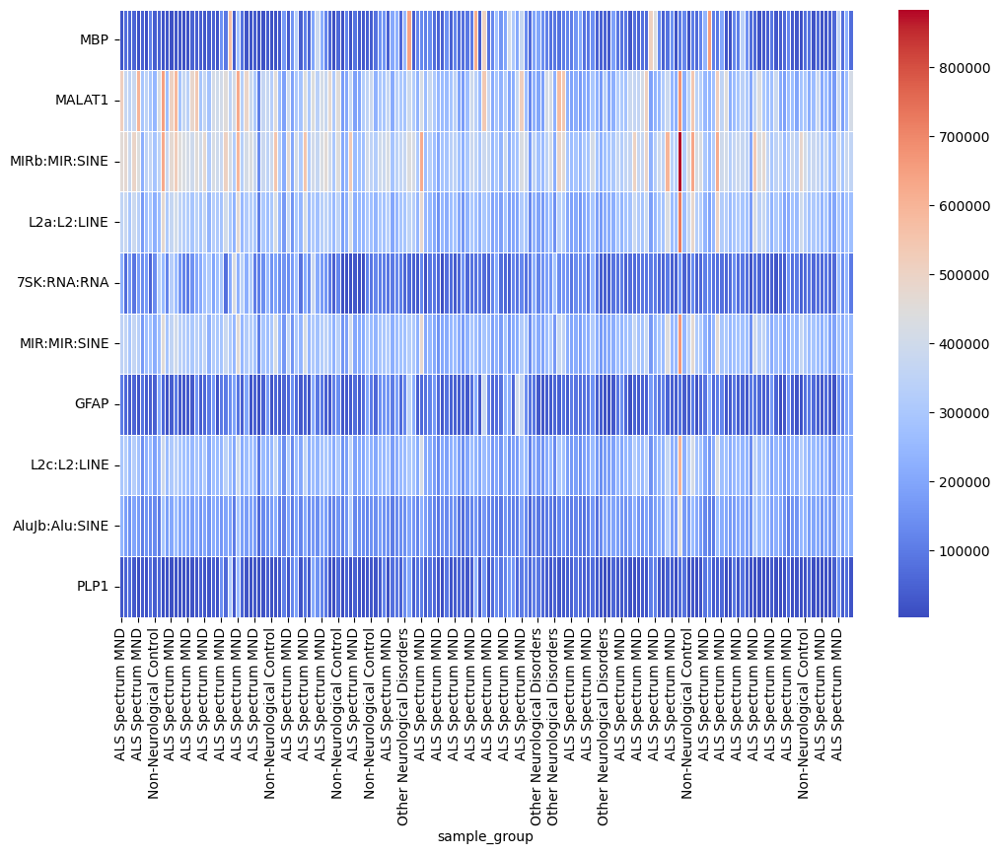

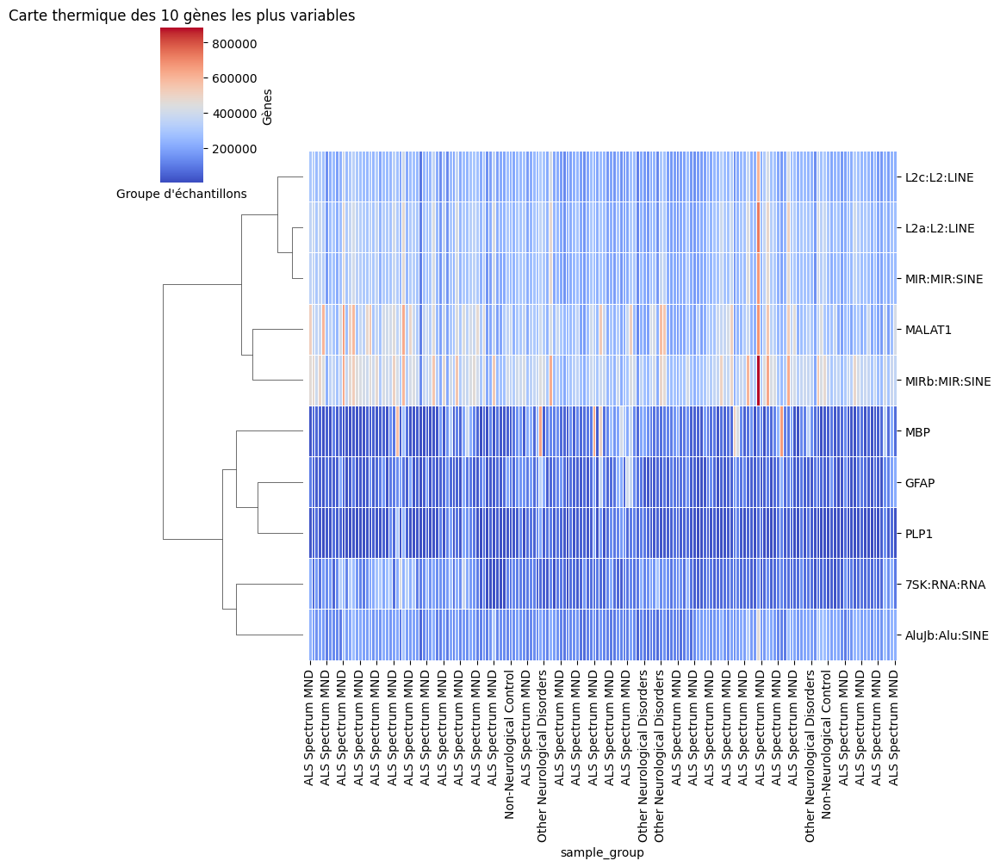

In [38]:
# df_stats_genes_sorted : Tri du DataFrame contenant les statistiques des gènes 
# (moyenne, médiane, écart-type) par ordre décroissant d'écart-type.
# Cela permet d'identifier les gènes dont l'expression varie le plus.
df_stats_genes_sorted = df_stats_genes.sort_values(by='standard_deviation', ascending=False)

# top_genes : Sélection des 10 gènes présentant la plus grande variabilité (plus grand écart-type).
# `head(10)` récupère les 10 premières lignes du DataFrame trié.
top_genes = df_stats_genes_sorted['gene'].head(10).tolist()

# Sous-ensemble des données : Sélection des données correspondant à chaque groupe d'échantillons (`sample_group`)
# et aux 10 gènes les plus variables.
df_heatmap = df_1.set_index('sample_group')[top_genes]

# Création de la heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(df_heatmap.transpose(), cmap='coolwarm', linewidths=0.5)  
# Transpose les données pour que les gènes apparaissent sur l'axe des y et les groupes d'échantillons sur l'axe des x.
sns.clustermap(df_heatmap.transpose(), cmap='coolwarm', linewidths=0.5, col_cluster=False)
plt.title("Carte thermique des 10 gènes les plus variables")
plt.xlabel("Groupe d'échantillons")
plt.ylabel("Gènes")
plt.show()


<Figure size 1200x800 with 0 Axes>

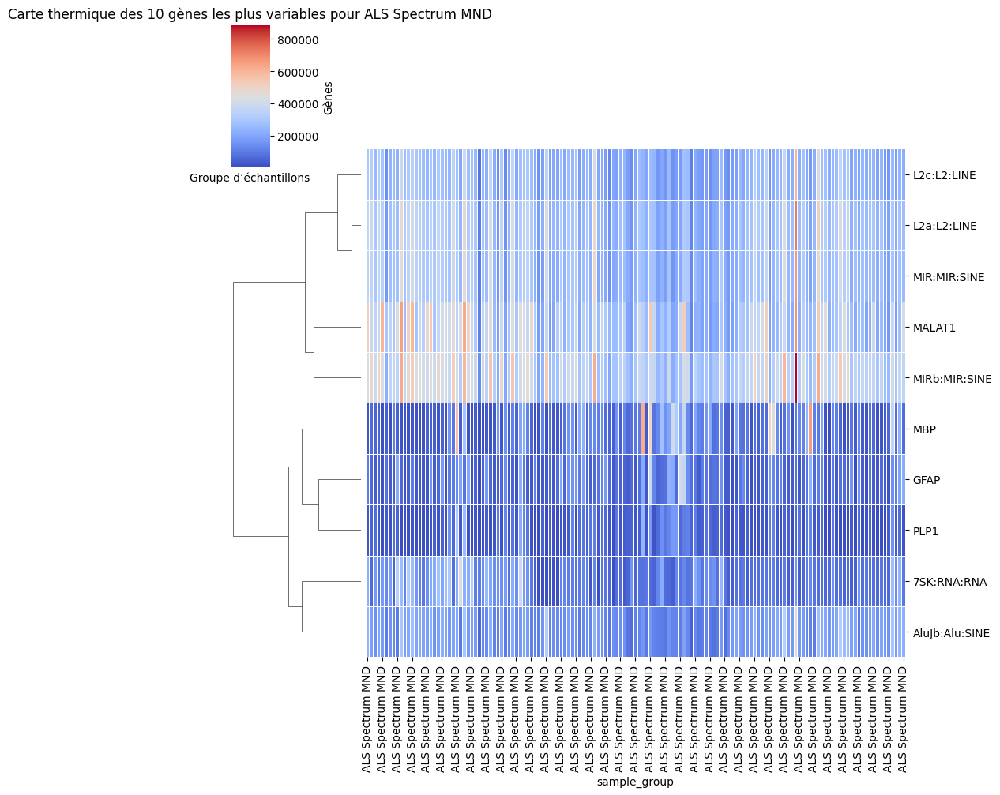

<Figure size 1200x800 with 0 Axes>

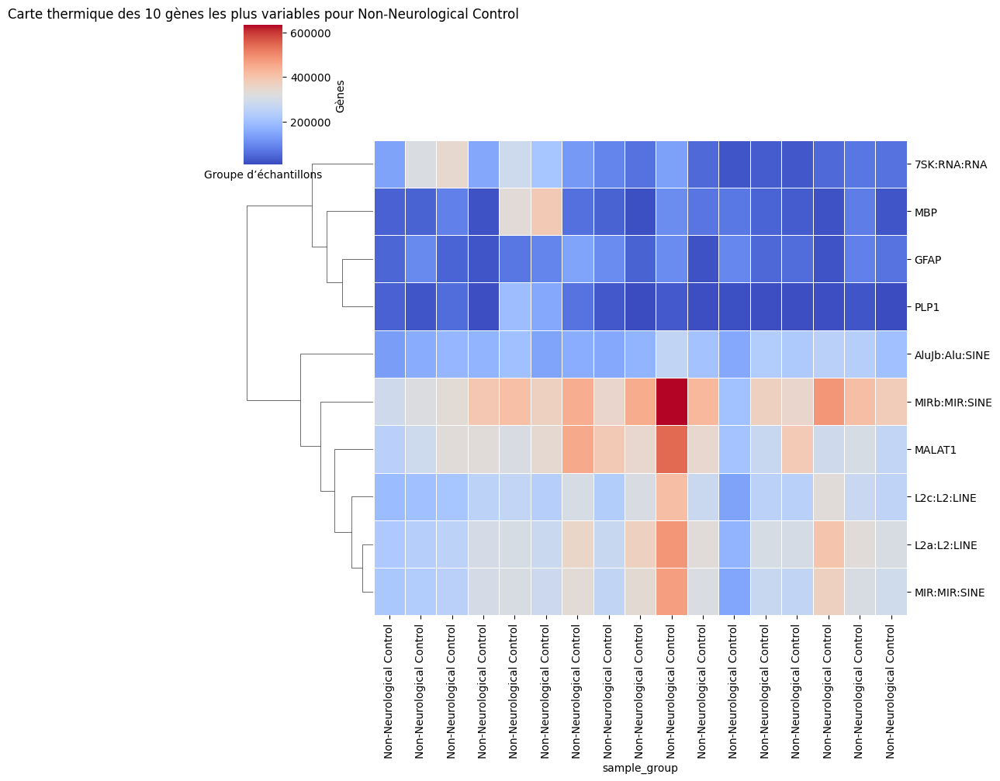

<Figure size 1200x800 with 0 Axes>

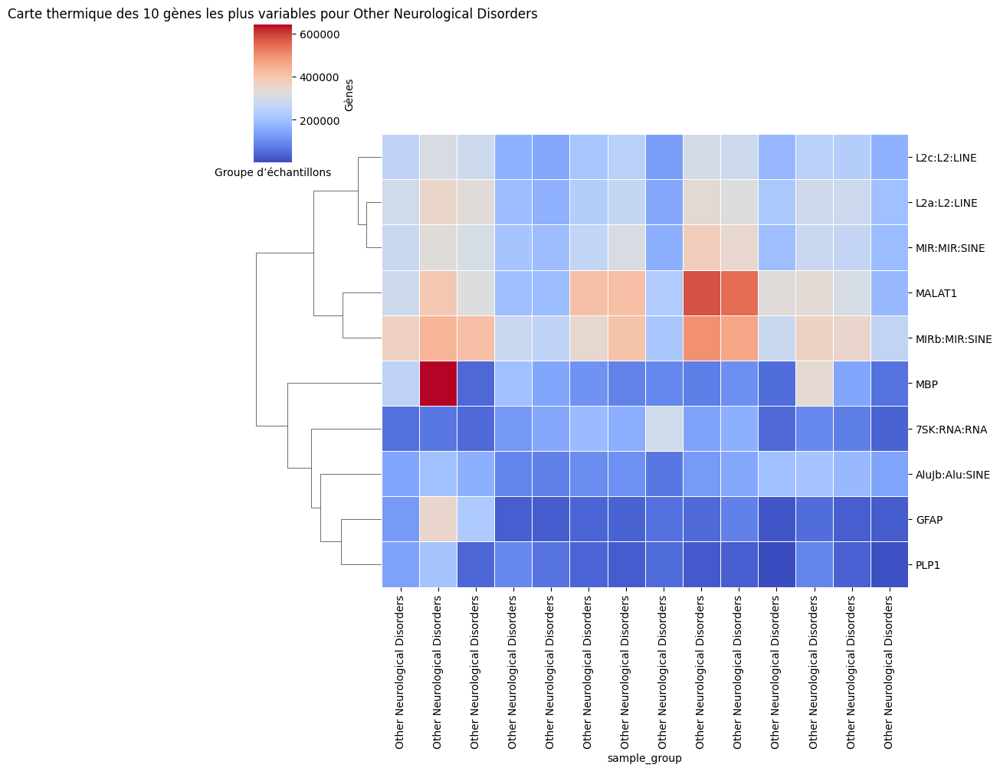

In [39]:
# Itération à travers chaque groupe d’échantillons (ex. : SLA, Contrôle et Autres troubles neurologiques)
for group in df_1['sample_group'].unique():  # Parcours de chaque groupe d’échantillons unique
    # Sous-ensemble des données : Filtrage du DataFrame pour le groupe actuel (ex. : SLA, Contrôle ou Autre)
    df_group = df_1[df_1['sample_group'] == group]
    
    # Sélectionner uniquement les colonnes correspondant aux 10 gènes les plus variables
    df_group_heatmap = df_group.set_index('sample_group')[top_genes]
    
    # Création de la heatmap pour le groupe d’échantillons actuel
    plt.figure(figsize=(12, 8))
    sns.clustermap(df_group_heatmap.transpose(), cmap='coolwarm', linewidths=0.5, col_cluster=False)  
    # Transpose les données pour afficher les gènes sur l’axe des y
    plt.title(f"Carte thermique des 10 gènes les plus variables pour {group}")  # Définir dynamiquement le titre pour chaque groupe
    plt.xlabel("Groupe d’échantillons")
    plt.ylabel("Gènes")
    plt.show()  # Afficher la carte thermique pour le groupe actuel

<u> Interprétations </u>

Ces différentes heatmap nous permettent de regarder quels sont les gènes qui se comportent de la même manière avec les échantillons. Les gènes reliés entre eux par des traits sur le côté gauche de la figure signifie que leur comportement est similaire avec les échantillons. 

Ces heatmap nous permettent également de voir quels sont les gènes qui sont très présents dans certains échantillons et très peu présents dans d'autres échantillons, lorsque la couleur devient de plus en plus orange, rouge alors cela signifie que le gène est très présents dans l'échantillon, à l'inverse si la couleur est très bleue alors cela signifie que le gène est très peu présent dans l'échantillon. 

Il est intéressant de comparer la présence des gènes en fonction des groupes des échantillons, c'est pourquoi on a plusieurs heatmap. En effet si on remarque qu'un gène est très présent dans un échantillon malade mais très peu dans un échantillon non malade, cela peut se révéler intéressant à analyser.
Par exemple on peut remarquer que le gène MIRb:MIR:SINE est beaucoup représenter chez les échantillons des groupes non malades, et un peu moins chez ceux du groupe ALS.

##### Box-plot 

C:\Users\firda\AppData\Local\Temp\ipykernel_23400\1370911419.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='sample_group', y=gene, data=df_1, palette='Set2')


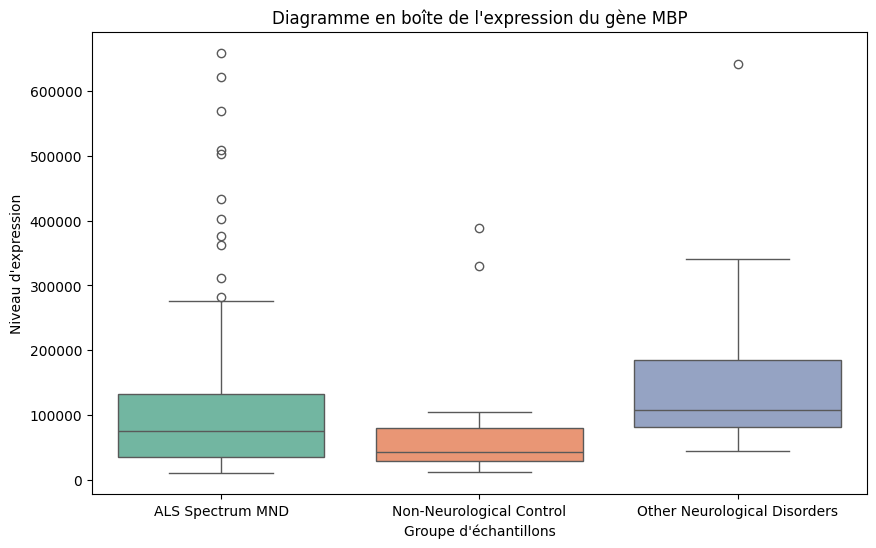

C:\Users\firda\AppData\Local\Temp\ipykernel_23400\1370911419.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='sample_group', y=gene, data=df_1, palette='Set2')


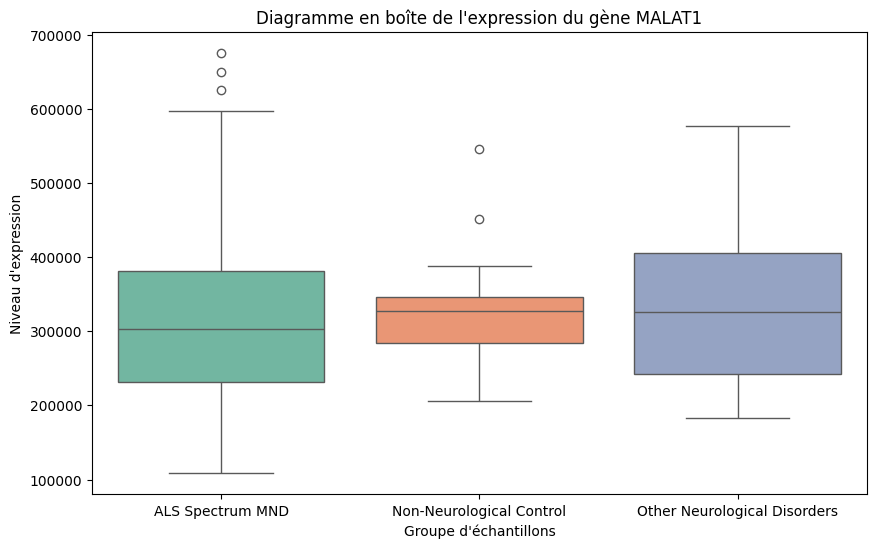

C:\Users\firda\AppData\Local\Temp\ipykernel_23400\1370911419.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='sample_group', y=gene, data=df_1, palette='Set2')


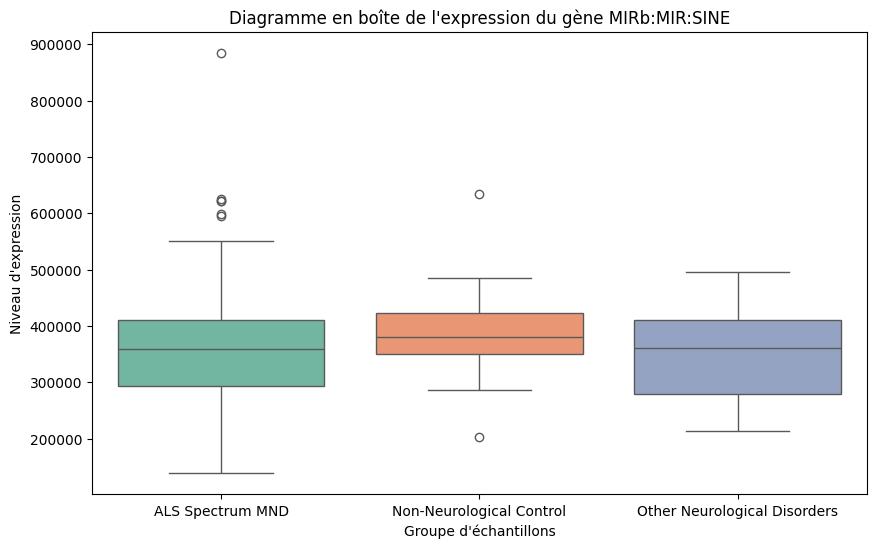

C:\Users\firda\AppData\Local\Temp\ipykernel_23400\1370911419.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='sample_group', y=gene, data=df_1, palette='Set2')


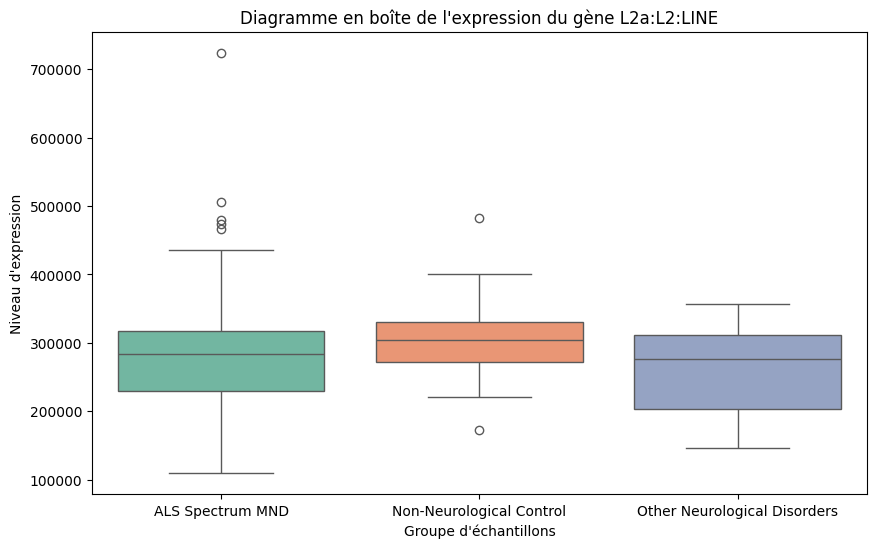

C:\Users\firda\AppData\Local\Temp\ipykernel_23400\1370911419.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='sample_group', y=gene, data=df_1, palette='Set2')


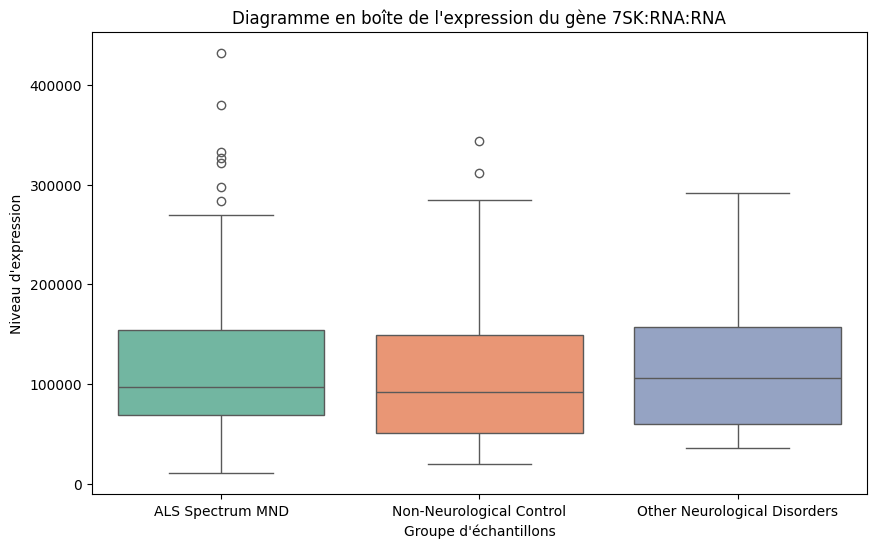

In [40]:
# Creation d'un box plot pour le 5 premiers gènes dans les groupes ALS et Contrôle
for gene in top_genes[:5]:
    plt.figure(figsize=(10, 6))  # Définir la taille de la figure

    # Créer un DataFrame pour le boxplot : Pour chaque gène, tracer les valeurs d'expression 
    # dans les groupes ALS et Contrôle
    # Filtrer les données pour le gène et créer des diagrammes en boîte groupés par sample_group (ALS vs Contrôle)
    sns.boxplot(x='sample_group', y=gene, data=df_1, palette='Set2')

    # Définir le titre et les étiquettes
    plt.title(f"Diagramme en boîte de l'expression du gène {gene}")  # Titre
    plt.xlabel("Groupe d'échantillons")  # Étiquette de l'axe X (ex : ALS vs Contrôle)
    plt.ylabel("Niveau d'expression")  # Étiquette de l'axe Y (niveaux d'expression du gène)

    # Afficher le graphique
    plt.show()


<u>Interprétation</u>

Ces box plot nous permettent de voir si un gène se comporterait de manière différente dans le groupe ALS par rapport au groupe controle. En effet, par exemple si la moyenne observée est très différente chez le groupe ALS par rapport à celle du groupe Control alors le gène pourrait être intéressant à récupérer pour essayer de comprendre si oui ou non c'est un gène important dans l'analyse.

Ces box plot nous permettent donc d'observer de manière visuelle si oui ou non un gène se comporte de manière très différente en fonction du groupe d'échantillon. Si c'est le cas, c'est intéressant de relever le gène pour l'analyse.

Pour les différents gènes choisis on remarque ici que la moyenne est à peu près la même pour tous les groupes, il n'est dons pas nécessaire de les relever.

### Encapsulation de l’analyse d’expression génique dans une classe

Pour organiser l’analyse des niveaux d’expression génique, nous avons regroupé toutes les étapes de calcul statistique dans une classe appelée GeneExpressionStats.
Cette classe permet de calculer automatiquement les statistiques (moyenne, médiane, écart-type) pour chaque gène, globalement et par groupe de patients.
Elle propose également des outils pour comparer les niveaux d’expression entre groupes et repérer les gènes les plus variables, ainsi qu’une fonction de transformation log2.
Cela nous permet de réutiliser ces fonctions facilement dans la suite de l’analyse.

In [41]:
class GeneExpressionStats:
    def __init__(self, data_matrix, data_annotation):
        """
        Classe permettant de calculer et analyser les statistiques d'expression génique.

        Paramètres :
        - data_matrix : DataFrame avec les gènes en colonnes et les échantillons en lignes
        - data_annotation : DataFrame contenant les informations de groupe pour chaque échantillon
        """
        self.data_matrix = data_matrix
        self.data_annotation = data_annotation.copy()
        self.data_annotation['sample_group'] = self.data_annotation['sample_group'].str.strip()

        # Calcul des stats globales dès l'initialisation
        self.stats_all = self._compute_global_stats()
        self.stats_by_group = self._compute_group_stats()

    def _compute_global_stats(self):
        """
        Calcule la moyenne, la médiane et l'écart-type pour chaque gène sur tous les échantillons.
        """
        return pd.DataFrame({
            'mean': self.data_matrix.mean(axis=0),
            'median': self.data_matrix.median(axis=0),
            'standard_deviation': self.data_matrix.std(axis=0)
        }).rename_axis("gene").reset_index()

    def _compute_group_stats(self):
        """
        Calcule les statistiques d'expression (mean, median, std) pour chaque gène,
        séparées par groupe de patients.
        """
        group_stats = {}
        for group in self.data_annotation['sample_group'].unique():
            sample_ids = self.data_annotation[self.data_annotation['sample_group'] == group]['Sample_id']
            subset = self.data_matrix.loc[sample_ids]
            group_stats[group] = {
                'mean': subset.mean(axis=0),
                'median': subset.median(axis=0),
                'std': subset.std(axis=0)
            }
        return group_stats

    def get_global_stats(self):
        """Retourne les statistiques globales (tous groupes confondus)."""
        return self.stats_all

    def get_group_stats(self):
        """Retourne les statistiques par groupe sous forme de dictionnaire."""
        return self.stats_by_group

    def get_stats_comparison(self):
        """
        Regroupe les moyennes par groupe dans un seul DataFrame pour comparaison directe.
        """
        comparison = pd.DataFrame({ 'gene': self.data_matrix.columns })
        for group, stats in self.stats_by_group.items():
            comparison[f'mean_{group.lower().replace(" ", "_")}'] = stats['mean'].values
        # Ajouter une colonne qui mesure l'écart max entre groupes (utile pour repérer gènes diff.)
        cols = [col for col in comparison.columns if col.startswith('mean_')]
        comparison['diff_between_groups'] = comparison[cols].max(axis=1) - comparison[cols].min(axis=1)
        return comparison

    def get_top_variable_genes(self, top_n=10):
        """
        Retourne les gènes ayant le plus fort écart-type global (les plus variables).
        """
        return self.stats_all.sort_values(by='standard_deviation', ascending=False).head(top_n)

    def log_transform(self):
        """
        Applique une transformation log2 à la matrice d'expression et met à jour les stats.
        Les zéros sont traités en ajoutant une pseudo-valeur (+1).
        """
        self.data_matrix = np.log2(self.data_matrix + 1)
        self.stats_all = self._compute_global_stats()
        self.stats_by_group = self._compute_group_stats()


In [42]:
# Importation et instanciation de la classe
gene_stats = GeneExpressionStats(
    data_matrix=als_tools.get_data_matrix(),
    data_annotation=als_tools.get_data_annotation()
)

# 1. Récupérer les statistiques globales (tous échantillons confondus)
df_global_stats = gene_stats.get_global_stats()
print("Statistiques globales (tous échantillons) :")
print(df_global_stats.head())


Statistiques globales (tous échantillons) :
       gene         mean  median  standard_deviation
0      A1BG    38.062500    34.0           20.511225
1  A1BG-AS1   118.568182   108.5           48.137849
2      A1CF     0.170455     0.0            0.662835
3       A2M  2455.403409  2286.5         1278.351971
4   A2M-AS1   102.568182    94.5           35.553998


In [43]:
#2. Récupérer les statistiques par groupe (ALS, Control, Other)
dict_group_stats = gene_stats.get_group_stats()
print("\nStatistiques par groupe :")
for group, stats in dict_group_stats.items():
    print(f"\n--- Groupe : {group} ---")
    print("Moyenne :")
    display(stats['mean'].head())
    print("Médiane :")
    display(stats['median'].head())
    print("Écart-type :")
    display(stats['std'].head())




Statistiques par groupe :

--- Groupe : ALS Spectrum MND ---
Moyenne :


A1BG          37.710345
A1BG-AS1     119.379310
A1CF           0.200000
A2M         2486.924138
A2M-AS1      103.503448
dtype: float64

Médiane :


A1BG          33.0
A1BG-AS1     109.0
A1CF           0.0
A2M         2222.0
A2M-AS1       95.0
dtype: float64

Écart-type :


A1BG          20.312803
A1BG-AS1      51.383778
A1CF           0.722649
A2M         1338.114568
A2M-AS1       35.813972
dtype: float64


--- Groupe : Non-Neurological Control ---
Moyenne :


A1BG          39.764706
A1BG-AS1     122.705882
A1CF           0.000000
A2M         2609.941176
A2M-AS1       92.470588
dtype: float64

Médiane :


A1BG          34.0
A1BG-AS1     124.0
A1CF           0.0
A2M         2560.0
A2M-AS1       88.0
dtype: float64

Écart-type :


A1BG         24.605714
A1BG-AS1     31.003558
A1CF          0.000000
A2M         975.340227
A2M-AS1      32.950944
dtype: float64


--- Groupe : Other Neurological Disorders ---
Moyenne :


A1BG          39.642857
A1BG-AS1     105.142857
A1CF           0.071429
A2M         1941.285714
A2M-AS1      105.142857
dtype: float64

Médiane :


A1BG          39.0
A1BG-AS1     101.0
A1CF           0.0
A2M         1890.0
A2M-AS1      103.0
dtype: float64

Écart-type :


A1BG         18.437450
A1BG-AS1     23.250665
A1CF          0.267261
A2M         816.736416
A2M-AS1      36.363247
dtype: float64

In [44]:
#3. Comparaison des moyennes entre groupes pour chaque gène
df_comparaison = gene_stats.get_stats_comparison()
print("\nComparaison des moyennes entre groupes :")
display(df_comparaison.head())



Comparaison des moyennes entre groupes :


,gene,mean_als_spectrum_mnd,mean_non-neurological_control,mean_other_neurological_disorders,diff_between_groups
0,A1BG,37.710345,39.764706,39.642857,2.054361
1,A1BG-AS1,119.379310,122.705882,105.142857,17.563025
2,A1CF,0.200000,0.000000,0.071429,0.200000
3,A2M,2486.924138,2609.941176,1941.285714,668.655462
4,A2M-AS1,103.503448,92.470588,105.142857,12.672269


In [45]:
#  4. Identifier les gènes les plus variables globalement
top_genes = gene_stats.get_top_variable_genes(top_n=10)
print("\nTop 10 des gènes les plus variables (écart-type) :")
display(top_genes)



Top 10 des gènes les plus variables (écart-type) :


,gene,mean,median,standard_deviation
14266,MBP,113231.880682,76634.5,123015.810490
14073,MALAT1,323309.613636,306062.5,109062.250425
28725,MIRb:MIR:SINE,366426.198864,361979.0,100627.553269
28282,L2a:L2:LINE,283476.306818,283464.5,81144.365698
27963,7SK:RNA:RNA,120296.278409,96781.5,80376.059393
28724,MIR:MIR:SINE,275949.971591,274796.5,76271.934981
7278,GFAP,84943.318182,63070.5,69832.718708
28284,L2c:L2:LINE,241241.857955,241840.5,67720.363522
27967,AluJb:Alu:SINE,165322.568182,160093.0,57001.837407
19593,PLP1,52353.181818,32645.5,52538.809139


In [46]:
# 5. Appliquer une transformation log2 pour stabiliser la variance
gene_stats.log_transform()
print("\n Transformation log2 appliquée avec succès.")
print("Nouvelle version des statistiques globales (après log) :")
display(gene_stats.get_global_stats().head())



 Transformation log2 appliquée avec succès.
Nouvelle version des statistiques globales (après log) :


,gene,mean,median,standard_deviation
0,A1BG,5.125116,5.129283,0.671608
1,A1BG-AS1,6.806046,6.774772,0.515441
2,A1CF,0.132382,0.000000,0.429035
3,A2M,11.071408,11.159486,0.758836
4,A2M-AS1,6.613522,6.577409,0.487305


## Etape 3 : Principle Component Analysis (PCA)

Comme on a constaté qu'il y a énormement de gènes , c'est pourquoi on a essayée de réduire les dimensions des donnée en utilisant la PCA

In [47]:
from sklearn.preprocessing import StandardScaler  # Importer StandardScaler pour normaliser les données
from sklearn.decomposition import PCA  # Importer PCA pour l'analyse en composantes principales

# Initialiser le standardiseur pour mettre les données à l'échelle (centrer et réduire)
scaler = StandardScaler()

# Récupérer la matrice de données, supprimer les doublons et appliquer la mise à l'échelle
X = scaler.fit_transform(als_tools.get_data_matrix().drop_duplicates())  

In [48]:
# Initialiser l'analyse en composantes principales (PCA) sans spécifier le nombre de composantes
pca = PCA()

# Ajuster le modèle PCA aux données mises à l'échelle
pca.fit(X)

# Transformer les données en utilisant les composantes principales
pca_data = pca.transform(X)

Pour choisir le nombre de composante qu'on veut garder , on trace un scree plot : 

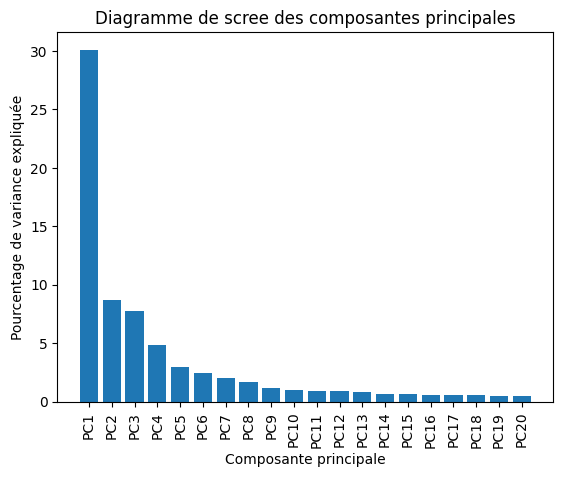

In [49]:
# Choisir le nombre de composantes principales à afficher  
per_var = np.round(pca.explained_variance_ratio_ * 100, decimals=1)  # Calculer la variance expliquée en pourcentage  
labels = ['PC' + str(x) for x in range(1, len(per_var) + 1)]  # Créer les étiquettes des composantes principales  

# Définir le nombre de composantes à afficher  
n_components_to_display = 20  

# Sélectionner uniquement les premières composantes pour l'affichage  
per_var_subset = per_var[:n_components_to_display]  
labels_subset = labels[:n_components_to_display]  

# Créer un diagramme en barres pour visualiser la variance expliquée par chaque composante principale  
plt.bar(x=range(1, n_components_to_display + 1), height=per_var_subset, tick_label=labels_subset)  
plt.ylabel('Pourcentage de variance expliquée')  # Étiquette de l'axe Y  
plt.xlabel('Composante principale')  # Étiquette de l'axe X  
plt.xticks(rotation='vertical')  # Faire pivoter les étiquettes des axes pour une meilleure lisibilité  
plt.title('Diagramme de scree des composantes principales')  # Titre du graphique  
plt.show()  # Afficher le graphique  

Suite à ce graphique , on a fait le choix de garder uniquement 5 composantes 

In [50]:
# Créer un DataFrame contenant les données transformées après PCA  
# Les lignes conservent les mêmes index que la matrice de données originale (sans doublons)  
# Les colonnes correspondent aux composantes principales (PC1, PC2, ...)  
pca_df = pd.DataFrame(
    data=pca_data,  
    index=als_tools.get_data_matrix().drop_duplicates().index,  
    columns=labels  
)

In [51]:
# Ajouter la colonne 'sample_group' au DataFrame PCA  
# Cela permet d'associer chaque échantillon à son groupe (ALS ou Contrôle)  
pca_df['sample_group'] = df_annot_idx['sample_group']  

# Afficher les premières lignes du DataFrame pour vérifier les données  
pca_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC168,PC169,PC170,PC171,PC172,PC173,PC174,PC175,PC176,sample_group
GSM3533230,63.338217,-13.651998,13.371173,57.694200,70.495532,-2.019582,-77.297032,9.496898,-7.280760,-2.496675,...,-0.535657,-0.385896,0.169617,1.270907,-1.011990,-0.322106,0.108761,0.030124,2.046823e-13,ALS Spectrum MND
GSM3533231,-27.705410,1.065093,-14.548488,42.500498,-15.111806,-4.363111,3.992265,-18.078441,-22.129497,-1.675777,...,-1.471329,-0.530124,3.391676,-0.867330,-2.214518,0.733973,-2.290758,1.037468,5.812067e-14,ALS Spectrum MND
GSM3533232,-54.598212,15.515728,-34.567249,30.406931,-8.968640,2.947985,6.632105,-9.827730,-23.349239,-2.886624,...,0.276598,-3.753535,-6.841441,-1.177608,0.600666,1.205563,0.859186,0.363477,-7.198663e-15,ALS Spectrum MND
GSM3533233,-60.568733,-14.416886,30.345590,53.151665,-10.737425,30.036483,8.739576,-5.052362,-16.198820,-5.333838,...,1.072960,-0.850422,1.035048,0.605997,0.123977,0.699688,0.286125,0.990079,-2.348322e-15,ALS Spectrum MND
GSM3533234,-19.600163,-21.833298,-44.672109,62.305530,2.121305,55.041867,-6.456916,-7.344563,-25.427134,-14.970579,...,3.183404,2.626978,-1.822943,1.661886,1.945700,1.251956,0.970826,0.215034,8.578701e-15,ALS Spectrum MND


**Représentation graphique de la PCA**

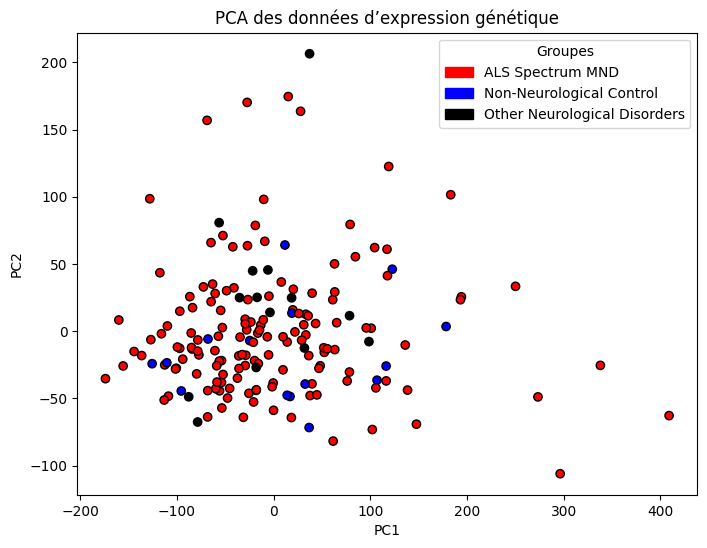

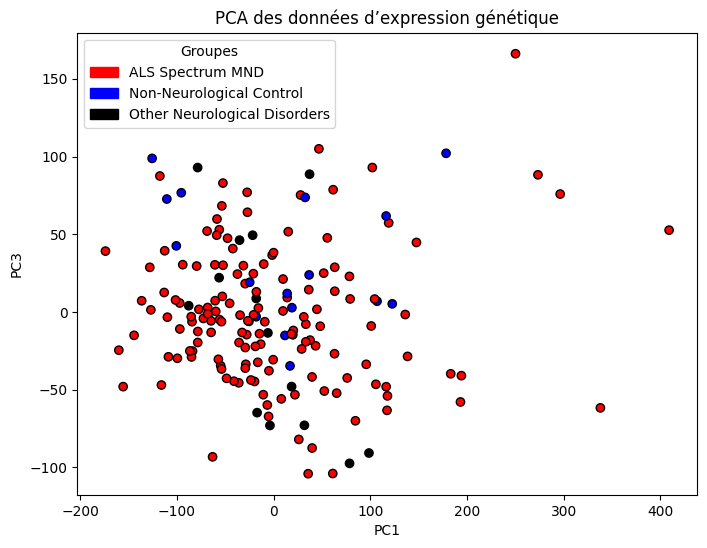

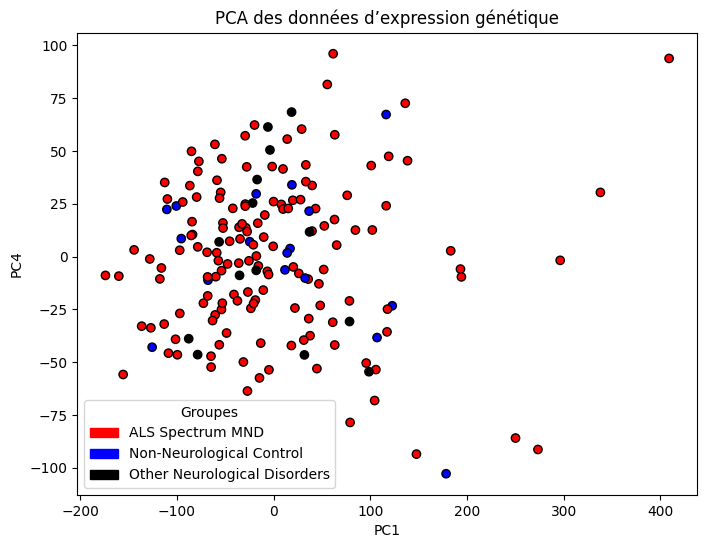

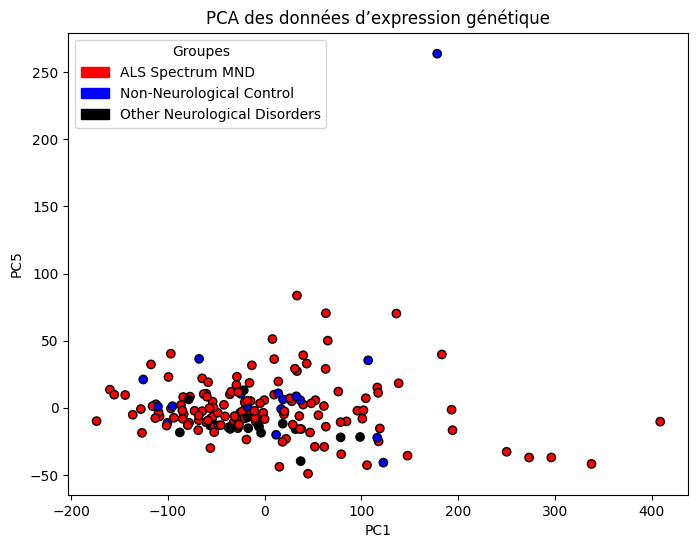

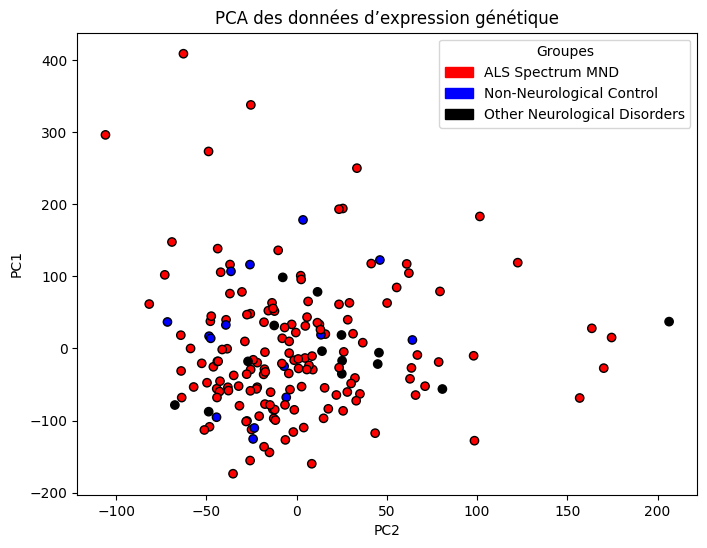

...

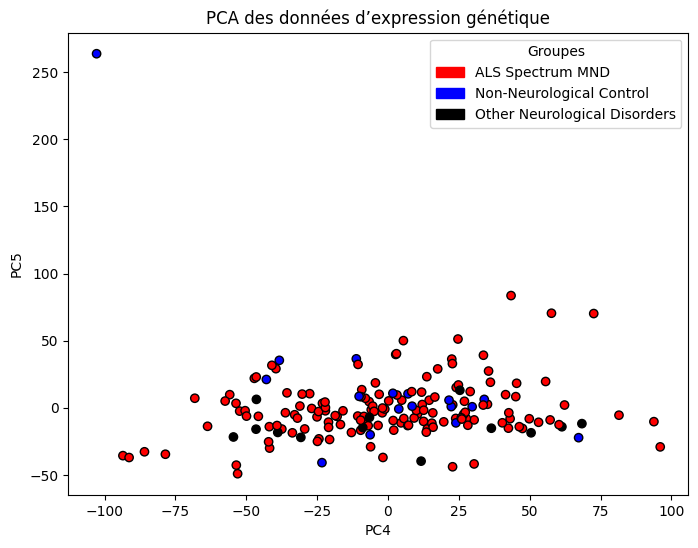

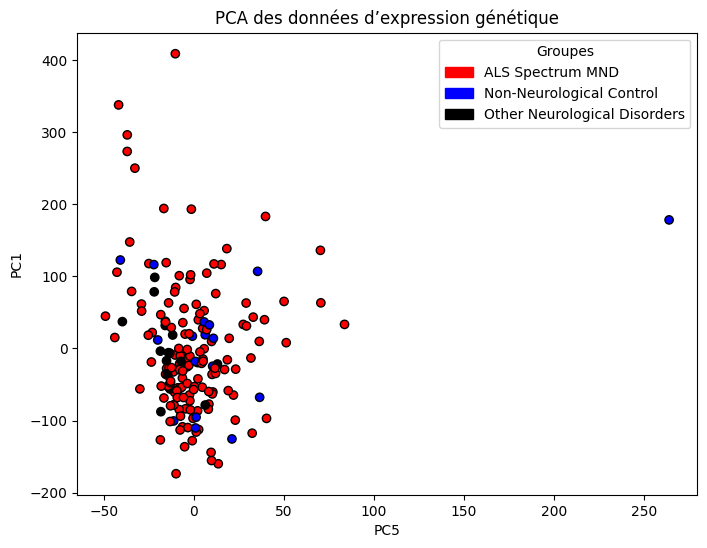

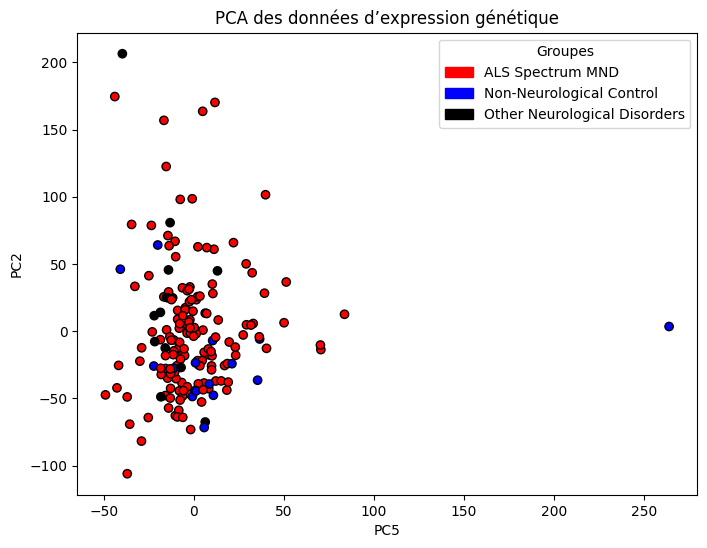

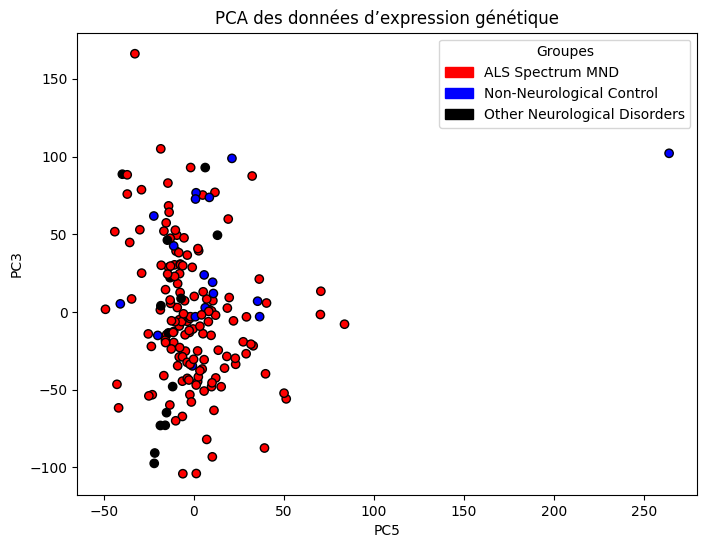

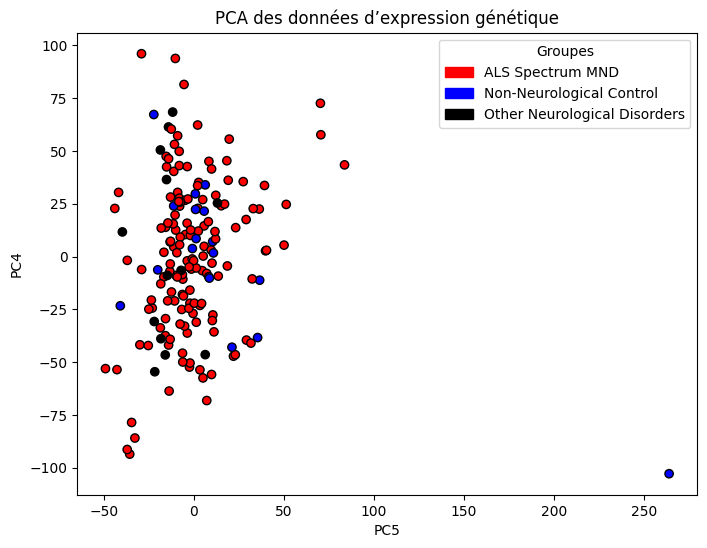

In [52]:
# Importer les outils pour créer une légende personnalisée  
import matplotlib.patches as mpatches  

# Définir les couleurs associées à chaque groupe d'échantillons  
color_sample = {
    'ALS Spectrum MND': 'red',  
    'Non-Neurological Control': 'blue',  
    'Other Neurological Disorders': 'black'  
}

# Mapper les couleurs aux groupes d'échantillons dans le DataFrame PCA  
colors = pca_df['sample_group'].map(color_sample)  

# Sélectionner les 5 premières composantes principales pour la visualisation  
nb_PC = ['PC' + str(x) for x in range(1, 6)]  

# Créer des graphiques en nuages de points pour chaque paire de composantes principales  
for i in range(len(nb_PC)):  
    for j in range(len(nb_PC)):  
        if i != j:  # Éviter de comparer une composante avec elle-même  
            plt.figure(figsize=(8, 6))  # Définir la taille du graphique  

            # Tracer les points en fonction des deux composantes principales sélectionnées  
            plt.scatter(pca_df[nb_PC[i]], pca_df[nb_PC[j]], c=colors, edgecolor='k')  

            # Ajouter un titre et des étiquettes d'axes  
            plt.title('PCA des données d’expression génétique')  
            plt.xlabel('PC' + f"{i+1}")  
            plt.ylabel('PC' + f"{j+1}")  

            # Ajouter une légende indiquant les groupes d'échantillons et leurs couleurs  
            handles = [mpatches.Patch(color=color, label=label) for label, color in color_sample.items()]  
            plt.legend(handles=handles, title="Groupes", loc='best')  

            # Afficher le graphique  
            plt.show()  


<u>Remarque</u>  
Contraitrement à ce qu'on a pensé, la PCA ne nous a pas permi de différencier les différentes classes.  
Cependant, cela nous a permi d'identifier des échantillon outliers

In [53]:
# Sélectionner les échantillons ayant une valeur inhabituelle pour certaines composantes principales  
w1 = pca_df[pca_df['PC5'] > 150]  # Échantillons avec PC5 > 150  
w2 = pca_df[pca_df['PC1'] > 250]  # Échantillons avec PC1 > 250  
w3 = pca_df[pca_df['PC3'] > 150]  # Échantillons avec PC3 > 150  

# Combiner les échantillons identifiés et supprimer les doublons  
weird_pca = pd.concat([w1, w2, w3]).drop_duplicates()  

# Afficher les échantillons détectés  
weird_pca  

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC168,PC169,PC170,PC171,PC172,PC173,PC174,PC175,PC176,sample_group
GSM3533251,178.387852,3.531653,102.100603,-102.832550,263.771771,69.626744,162.161005,-55.464437,-40.317404,1.214872,...,0.045298,-0.142555,-0.020923,0.145906,0.205062,-0.022277,-0.266737,-0.096789,1.301439e-14,Non-Neurological Control
GSM3533302,337.901551,-25.380774,-61.651333,30.393159,-41.749241,-1.300074,16.590062,-35.076264,-15.505316,32.363223,...,0.031121,0.365586,-1.727717,1.623314,-0.723585,2.405906,1.320406,0.797499,1.523039e-15,ALS Spectrum MND
GSM3533361,296.329937,-105.953122,75.885857,-1.778504,-36.940212,-7.443762,-13.682008,-6.719923,-2.954573,-32.634147,...,-0.089047,0.298719,-0.502921,1.317781,0.938736,1.199083,-0.634780,0.174668,5.647018e-15,ALS Spectrum MND
GSM3533364,408.919458,-62.738975,52.669479,93.846189,-10.267186,-70.824588,16.888789,-36.105273,51.050247,16.375502,...,0.451811,-0.917471,-0.070041,1.286621,-0.860399,2.046138,0.187014,1.003800,2.107565e-14,ALS Spectrum MND
GSM3533402,250.168987,33.405625,166.157513,-85.932252,-32.708483,58.361206,-65.365324,-9.012275,-26.895506,-4.747302,...,-0.009701,-0.943374,0.256051,0.516218,-0.333775,-0.257210,0.557130,0.448971,5.793245e-14,ALS Spectrum MND
GSM3533404,273.361919,-48.820609,88.271117,-91.358294,-36.977488,16.739237,-12.662805,40.114952,-6.462141,-21.549386,...,0.596258,-0.149700,-0.417559,0.748643,-0.225066,0.616541,-0.005817,0.138819,1.684526e-13,ALS Spectrum MND


## Etape 4 : tSNE et UMAP

Ici on implémente deux méthodes de réduction de dimensionnalité non linéaires :
 - t-SNE (t-distributed stochastic neighbor embedding)
 - UMAP (Uniform Manifold Approximation and Projection)
Ces deux techniques permettent de projeter les données de très haute dimension (comme les données d'expression génique) dans un espace de 2 dimensions tout en conservant les structures locales des données.
Contrairement au PCA, elles ne permettent pas d'interpréter les distances globales.


In [54]:
#!pip install umap-learn


C:\Users\firda\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


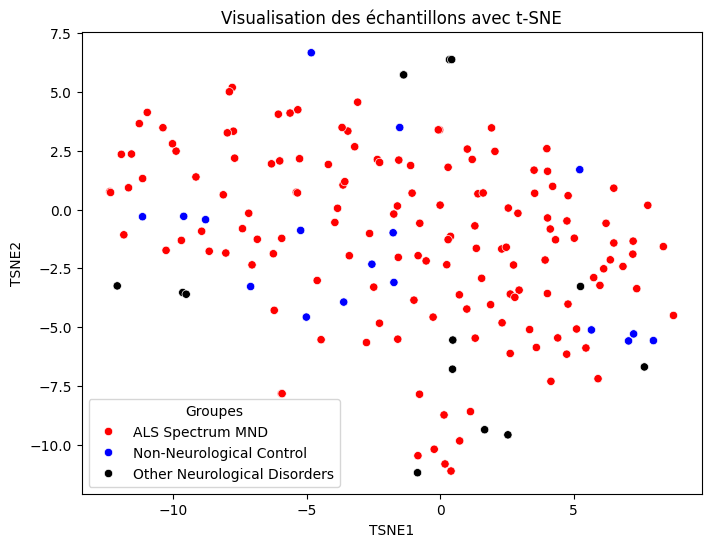

C:\Users\firda\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\firda\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


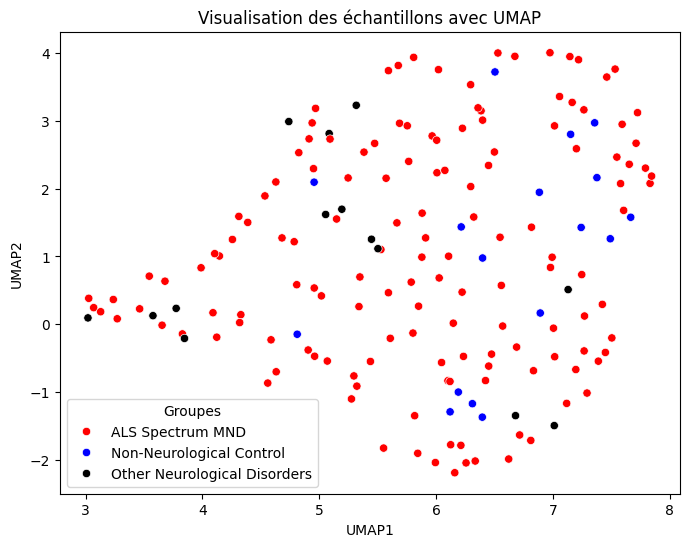

In [ ]:
from sklearn.manifold import TSNE              # Pour la réduction de dimension t-SNE
import umap                                    # Pour la réduction de dimension UMAP


# Étape 1 - Standardisation des données d'expression génique (centrer et réduire)
# Cela permet de s'assurer que tous les gènes sont sur la même échelle
scaler = StandardScaler()
X_scaled = scaler.fit_transform(als_tools.get_data_matrix().drop_duplicates())  # Standardisation
sample_ids = als_tools.get_data_matrix().drop_duplicates().index  # Conserver les identifiants d’échantillons

# Étape 2 - Récupération des groupes d'échantillons pour la légende (annotations)
annotations = als_tools.get_data_annotation().set_index('Sample_id').loc[sample_ids]
groups = annotations['sample_group'].str.strip()  # Supprimer les espaces blancs inutiles

#Définir les couleurs à utiliser pour chaque groupe dans les visualisations
colors_map = {
    'ALS Spectrum MND': 'red',
    'Non-Neurological Control': 'blue',
    'Other Neurological Disorders': 'black'
}
colors = groups.map(colors_map)  # Associer chaque échantillon à une couleur selon son groupe

#  Étape 3 - Réduction de dimension avec t-SNE
# t-SNE cherche à préserver les similarités locales (proximité entre échantillons)
tsne = TSNE(n_components=2, random_state=42, perplexity=30)  # Initialisation du modèle t-SNE
tsne_result = tsne.fit_transform(X_scaled)  # Transformation des données
tsne_df = pd.DataFrame(tsne_result, columns=['TSNE1', 'TSNE2'], index=sample_ids)  # Mise en DataFrame
tsne_df['group'] = groups  # Ajout de la colonne groupe

# Affichage du scatterplot t-SNE
plt.figure(figsize=(8, 6))
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', hue='group', palette=colors_map)
plt.title("Visualisation des échantillons avec t-SNE")  # Titre du graphique
plt.legend(title="Groupes")  # Légende des couleurs
plt.show()

#Étape 4 - Réduction de dimension avec UMAP
# UMAP est une méthode plus récente, réputée pour préserver davantage les distances globales
reducer = umap.UMAP(n_components=2, random_state=42)  # Initialisation du modèle UMAP
umap_result = reducer.fit_transform(X_scaled)  # Transformation des données
umap_df = pd.DataFrame(umap_result, columns=['UMAP1', 'UMAP2'], index=sample_ids)  # Mise en DataFrame
umap_df['group'] = groups  # Ajout de la colonne groupe

#Affichage du scatterplot UMAP
plt.figure(figsize=(8, 6))
sns.scatterplot(data=umap_df, x='UMAP1', y='UMAP2', hue='group', palette=colors_map)
plt.title("Visualisation des échantillons avec UMAP")  # Titre du graphique
plt.legend(title="Groupes")  # Légende des couleurs
plt.show()


Les représentations obtenues avec t-SNE et UMAP permettent de visualiser les relations de similarité locale entre les échantillons, en particulier autour des groupes définis par les annotations.

 - t-SNE :

Les échantillons du groupe ALS Spectrum MND (en rouge) sont présents dans presque tout l’espace, ce qui suggère une forte variabilité intra-groupe.

Les groupes Contrôle (bleu) et Other (noir) ne forment pas de clusters très compacts, mais certains sous-ensembles semblent tout de même se rapprocher.

On observe quelques points isolés : ces échantillons pourraient être des outliers potentiels, mais t-SNE n’est pas la méthode la plus fiable pour les identifier à cause de sa nature non linéaire.

 - UMAP :
 
Le groupe ALS apparaît également très répandu dans l’espace projeté, mais on note une distribution en arc plus structurée que sur t-SNE.

UMAP semble mieux regrouper les points du même groupe dans certaines zones, notamment pour les Contrôles, qui apparaissent davantage concentrés.

La structure est plus continue et fluide : cela peut indiquer des gradients biologiques ou des effets de batch entre les individus.

 À noter :

Des échantillons apparaissent visuellement très éloignés des centres (surtout en t-SNE). Ce sont de bons candidats pour une vérification en tant qu'outliers.

## Etape 5 : Analyse Univariée 

Une fois qu'on  a analyser les données et essayer de réduire les dimensions, on a pris conscience qu'il faudrait utiliser une technique plus adapté à notre probleme : DeSeq2

En effet, DeSeq2 va nous permettre de réaliser une analyse differentielle sur des données d'ARN-seq en vrac.  
Cela, nous sera particulièrement utile pour **identifier les changements d'expression génique en réponse à différentes conditions**

In [56]:
import os  
import pickle as pkl  

import numpy as np  

from pydeseq2.dds import DeseqDataSet  # Importer le module pour créer un ensemble de données DESeq2  
from pydeseq2.default_inference import DefaultInference  # Importer l'outil d'inférence par défaut  
from pydeseq2.ds import DeseqStats  # Importer le module pour les statistiques DESeq2  
from pydeseq2.utils import load_example_data  # Importer la fonction pour charger des données d'exemple  

In [57]:
# Initialiser l'inférence avec 8 cœurs pour le traitement parallèle  
inference = DefaultInference(n_cpus=8)  

# Créer un objet DeseqDataSet pour l'analyse différentielle d'expression  
dds = DeseqDataSet(
    counts=als_tools.get_data_matrix().drop_duplicates(),  # Charger la matrice d'expression génique après suppression des doublons  
    metadata=df_annot_idx,  # Fournir les métadonnées associées aux échantillons  
    design_factors="sample_group",  # Comparer les échantillons en fonction du groupe (ALS vs Contrôle)  
    refit_cooks=True,  # Ajuster les valeurs de Cook pour une meilleure robustesse des résultats  
    inference=inference,  # Utiliser l'inférence par défaut avec le nombre de cœurs spécifié  
)

C:\Users\firda\AppData\Local\Temp\ipykernel_23400\1110167055.py:5: DeprecationWarning: design_factors is deprecated and will soon be removed.Please consider providing a formulaic formula using the design argumentinstead.
  dds = DeseqDataSet(


In [58]:
dds.deseq2()  # Applique la normalisation, l'ajustement statistique et le test de significativité

Fitting size factors...


Using None as control genes, passed at DeseqDataSet initialization


... done in 0.25 seconds.

Fitting dispersions...
... done in 7.88 seconds.

Fitting dispersion trend curve...
... done in 0.50 seconds.

Fitting MAP dispersions...
... done in 10.28 seconds.

Fitting LFCs...
... done in 4.42 seconds.

Calculating cook's distance...
... done in 0.47 seconds.

Replacing 221 outlier genes.

Fitting dispersions...
... done in 0.27 seconds.

Fitting MAP dispersions...
... done in 0.23 seconds.

Fitting LFCs...
... done in 0.19 seconds.



<u> Remarque </u>  

Pour l'analyse de l'expression différentielle des gène , on a choisi de comparer le groupe ALS et les controles

In [59]:
# Effectue une analyse de l'expression différentielle des gènes en utilisant DESeq2.
# Compare l'expression génique entre le groupe "ALS Spectrum MND" et le groupe "Non-Neurological Control".
stat_deseq = DeseqStats(dds, contrast=["sample_group", "ALS Spectrum MND", "Non-Neurological Control"])

In [60]:
# Affiche un résumé des résultats de l'analyse DESeq2.
# Fournit des informations statistiques clés sur les gènes différentiellement exprimés.
stat_deseq.summary()

Running Wald tests...


Log2 fold change & Wald test p-value: sample_group ALS Spectrum MND vs Non-Neurological Control
                           baseMean  log2FoldChange     lfcSE      stat  \
A1BG                      35.993902       -0.018089  0.142838 -0.126642   
A1BG-AS1                 113.742747       -0.052983  0.099893 -0.530397   
A1CF                       0.155759        0.590130  1.708666  0.345375   
A2M                     2345.384523       -0.119104  0.159463 -0.746904   
A2M-AS1                   99.268405        0.186492  0.098238  1.898372   
...                             ...             ...       ...       ...   
X8_LINE:CR1:LINE         458.855014       -0.058600  0.103845 -0.564304   
X9_LINE:L1:LINE          109.576015        0.073882  0.111311  0.663748   
Zaphod2:hAT-Tip100:DNA   411.010268       -0.065308  0.105927 -0.616537   
Zaphod3:hAT-Tip100:DNA  1539.491230       -0.107348  0.107400 -0.999510   
Zaphod:hAT-Tip100:DNA   1710.104347       -0.084253  0.097368 -0.865303   

   

... done in 5.09 seconds.



Une fois qu'on a calculé la difference d'expression génique,on a représenté cela grâce un volcano plot : 

In [61]:
# on récupère résultats de l'analyse d'expression différentielle effectuée
results = stat_deseq.results_df 

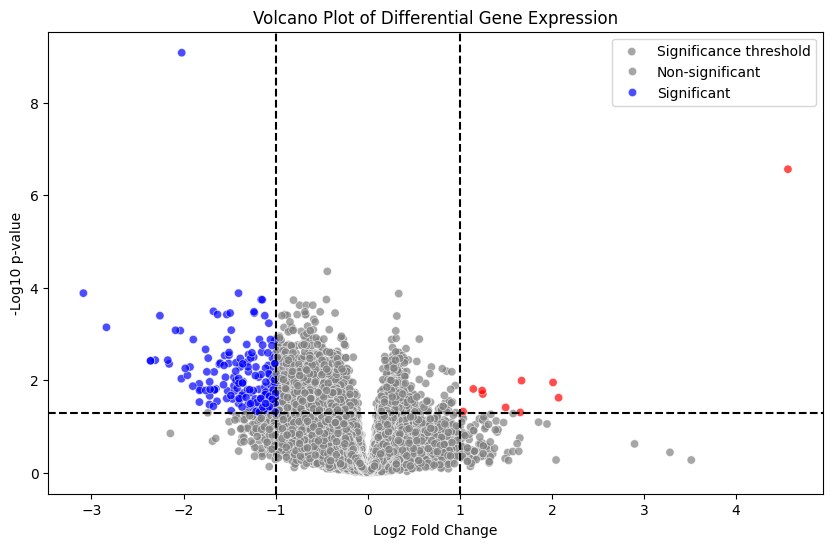

In [62]:
import matplotlib.pyplot as plt
import seaborn as sns

# Définir la couleur en fonction du log2FoldChange et du seuil de significativité
conditions = [
    (results["log2FoldChange"] > 1) & (results["padj"] < 0.05),  # Gènes avec log2FoldChange positif et significatif
    (results["log2FoldChange"] < -1) & (results["padj"] < 0.05),  # Gènes avec log2FoldChange négatif et significatif
    (results["padj"] >= 0.05)  # Gènes non significatifs
]

# Définir les couleurs pour chaque condition
colors = ['red', 'blue', 'gray']

# Appliquer les conditions pour définir la couleur de chaque point
results['color'] = np.select(conditions, colors, default='gray')


# Volcano Plot
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=results["log2FoldChange"],
    y=-np.log10(results["padj"]),
    hue=results["color"],  # Utiliser la couleur définie précédemment
    palette={"red": "red", "blue": "blue", "gray": "gray"},
    alpha=0.7
)
plt.axhline(-np.log10(0.05), linestyle="--", color="black", label="p=0.05")
plt.axvline(x=-1, color='black', linestyle='--') 
plt.axvline(x=1, color='black', linestyle='--') 
plt.xlabel("Log2 Fold Change")
plt.ylabel("-Log10 p-value")
plt.title("Volcano Plot of Differential Gene Expression")
plt.legend(["Significance threshold", "Non-significant", "Significant"])
plt.show()

<u> Interprétation </u>  
En bleu on a les gènes les moins exprimés dans ALS   
En rouge on a les gènes les plus exprimés dans ALS spectrum 

**Sélection des gènes les plus significatifs**

In [63]:
# Obtenir les résultats et filtrer par FDR < 0.05
# (FDR = False Discovery Rate)
significant_genes = results[results["padj"] < 0.05]
significant_genes

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,color
A3GALT2,2.591343,-1.238153,0.290134,-4.267515,0.000020,0.003166,blue
AANAT,2.773223,-0.743329,0.256454,-2.898488,0.003750,0.043732,gray
ABCB8,452.508149,-0.380587,0.111679,-3.407862,0.000655,0.018211,gray
ABCC1,446.619429,-0.228270,0.076154,-2.997484,0.002722,0.036736,gray
ABCC10,260.105293,-0.417270,0.138145,-3.020521,0.002523,0.035168,gray
...,...,...,...,...,...,...,...
MSR1:Satellite:Satellite,217.254453,-0.628589,0.148851,-4.222942,0.000024,0.003380,gray
PRIMA41-int:ERV1:LTR,581.463863,-0.326744,0.112853,-2.895299,0.003788,0.044010,gray
REP522:telo:Satellite,155.382458,-0.523728,0.181148,-2.891167,0.003838,0.044082,gray
Ricksha_a:MuDR:DNA,45.348024,-0.446807,0.129165,-3.459196,0.000542,0.016625,gray


En ne gardant que les gènes les plus significatifs en fonction de la FDR , on obtient 2 278 gènes.  
On a également filtré ces gènes par rapport au log2FoldChange qui quantifie le changement relatif d'expression d'un gène en fonction des conditions. On obtient donc au total 191 gènes significatifs

In [64]:
significant_genes_up = significant_genes[significant_genes["log2FoldChange"] > 1]
significant_genes_up.shape

(10, 7)

In [65]:
significant_genes_down = significant_genes[significant_genes["log2FoldChange"] <-1]
significant_genes_down.shape

(181, 7)

In [66]:
# on sauvegarde les gènes selectionnés dans un fichier csv 
pd.concat([significant_genes_down, significant_genes_up]).sort_values(by= "log2FoldChange", key=abs).to_csv("significant_genes_DeSeq.csv")

## Etape 6 : Analyse Multivariée - Elastic-Net (Option 1)

On a réalisé une première sélection de gènes significatifs avec la méthode DeSeq. Cependant cette méthode ne prend pas en compte les combinaisons possibles des gènes. C'est pourquoi, il est plus interressant d'utiliser la méthode Elastic-Net

Elastic-Net est un modèle de pénalité qui va nous permettre de sélectionner automatiquement les gènes les plus variables. 

In [67]:
from sklearn.linear_model import LogisticRegression

# Récupération de la matrice de données X
x = als_tools.get_data_matrix()

# Récupération des annotations des échantillons (étiquettes cibles y)
y = als_tools.get_data_annotation()['sample_group']

# Initialisation et entraînement d'un modèle de régression logistique avec pénalité ElasticNet
elasticNet = LogisticRegression(penalty='elasticnet', solver='saga', l1_ratio=0.5, C=0.5).fit(x, y)


C:\Users\firda\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


On met donc en place le modèle de régression logistitque avec la pénalité elasticNet. 

Notons que lors de l'exploration on a constaté qu'il y a un déséquilibre entre les deux groupes ALS et contrôle.  

On a donc précisé cela au modèle en utilisant balanced_accuracy

In [68]:
from sklearn.linear_model import LogisticRegressionCV 
import warnings 

# Ignorer les avertissements pour éviter l'affichage de messages non critiques
warnings.filterwarnings("ignore")
# Normalise les données 
scaler = StandardScaler()
X_scaled = scaler.fit_transform(x)

# Création et entraînement d'un modèle de régression logistique avec validation croisée
elasticNet = LogisticRegressionCV(
    penalty='elasticnet',   # Utilisation de la régularisation Elastic Net
    cv=3,                   # Validation croisée à 3 folds (divise les données en 3 sous-ensembles pour validation)
    solver='saga',          # Algorithme d'optimisation supportant Elastic Net et les grands jeux de données
    l1_ratios=[0.25, 0.5, 0.75],  # Différents ratios entre L1 (lasso) et L2 (ridge) à tester
    Cs=[0.1, 0.5],          # Valeurs possibles de C (inverse de la force de régularisation)
    scoring='balanced_accuracy'  # Utilisation du score d'accuracy équilibré comme métrique d'évaluation
).fit(X_scaled, y)  # Entraînement du modèle avec les données (x : features, y : labels)


**Prédiction et calcul du score**

In [69]:
import sklearn 

# Prédiction des étiquettes sur l'ensemble d'entraînement
model_prediction = elasticNet.predict(x)

# Calcul de l'accuracy (précision) sur l'ensemble d'entraînement
accuracy_train_dataset = sklearn.metrics.accuracy_score(y, model_prediction)

# Affichage de l'accuracy
accuracy_train_dataset


0.8465909090909091

Une fois qu'on a évalué le modèle , on a sélectionnés les 100 premiers gènes en fonction du coefficient 

In [70]:
# Extraction des coefficients du modèle ElasticNet
coef = elasticNet.coef_[0]  # Les coefficients des variables (car il s'agit d'un modèle multivarié)

# Récupération des noms des gènes (colonnes de la matrice X)
genes = x.columns  

# Création d'un DataFrame pour stocker l'importance des gènes
gene_importance = pd.DataFrame({
    'Gene': genes,              # Nom du gène
    'Coefficient': coef,        # Coefficient associé à chaque gène dans le modèle
    'AbsCoefficient': np.abs(coef)  # Valeur absolue du coefficient (importance du gène)
})

# Tri des gènes par importance décroissante (coefficient absolu)
gene_importance = gene_importance.sort_values(by='AbsCoefficient', ascending=False)

# Sélection des gènes ayant un impact non nul (coefficient différent de 0)
top_genes = gene_importance[gene_importance['AbsCoefficient'] > 0]

# Affichage des 100 gènes les plus importants
print(top_genes.head(100))  # Affiche les 100 premiers gènes les plus influents selon le modèle

            Gene  Coefficient  AbsCoefficient
22625    SLC2A14    -0.011951        0.011951
4411      CXCL11    -0.010909        0.010909
5627        ELF3    -0.010064        0.010064
19431     PKD1L3    -0.010056        0.010056
448    AFAP1-AS1     0.009638        0.009638
...          ...          ...             ...
21580       RRAD    -0.004706        0.004706
18440     OR5B17    -0.004698        0.004698
26889       WIF1    -0.004684        0.004684
4610        DBET    -0.004665        0.004665
9711      KLHL41    -0.004637        0.004637

[100 rows x 3 columns]


In [71]:
top_genes.head(100).to_csv("top_genes_elasticNet.csv",index=False)

## Etape 7 : Analyse Multivariée XGBOOST (Option 2)

On a également utilisé une autre méthode qui prend en compte les combinaisons possibles des gènes : XGBOOST  
Cette méthode créer un arbre de décision; puis se base sur les erreurs effectuée sur cet arbre pour en créant un autre avec moins d'erreurs.

<u>Remarques </u>  
La méthode XGBoost necessite des labels numérique , on a donc réalisé un encodage simple ( 0 ou 1 selon le groupe)

In [72]:
from xgboost import XGBClassifier  
from sklearn.preprocessing import LabelEncoder  
from sklearn.model_selection import train_test_split  

# Encodage des étiquettes de classe sous forme numérique (ex: "ctrl" → 0, "ALS" → 1)
label_encoder = LabelEncoder()
y_new = label_encoder.fit_transform(y)  # Transformation des étiquettes textuelles en valeurs numériques
# Normalisez les données
scaler = StandardScaler()
X_scaled = scaler.fit_transform(x)
# Division des données en train/test avec stratification (prend en compte le déséquilibre)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_new, test_size=0.2, random_state=42, stratify=y_new)
# Initialisation du modèle XGBoost
model = XGBClassifier()

# Entraînement du modèle sur les données
model.fit(X_train, y_train)  # x est la matrice des caractéristiques, y_new sont les étiquettes encodées

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              feature_weights=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=None,
              n_jobs=None, num_parallel_tree=None, ...)

In [73]:
# Afficher la correspondance entre les labels originaux et encodés
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Correspondance des labels :", label_mapping)

Correspondance des labels : {'ALS Spectrum MND': 0, 'Non-Neurological Control': 1, 'Other Neurological Disorders': 2}


In [74]:
import sklearn 

# Prédiction des étiquettes sur l'ensemble d'entraînement
model_prediction = model.predict(X_test)

# Calcul de l'accuracy (précision) sur l'ensemble d'entraînement
accuracy_train_dataset = sklearn.metrics.accuracy_score(y_test, model_prediction)

# Affichage de l'accuracy
accuracy_train_dataset


0.8611111111111112

<Axes: title={'center': 'Feature importance'}, xlabel='Importance score', ylabel='Features'>

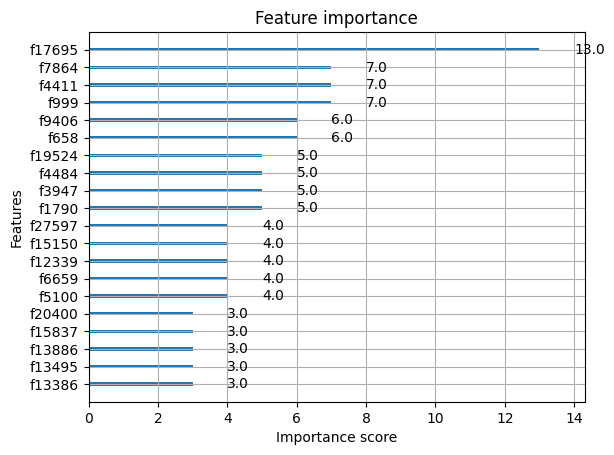

In [75]:
from xgboost import plot_importance 

# Affichage des 20 caractéristiques (features) les plus importantes selon le modèle XGBoost
plot_importance(model, max_num_features=20)


In [76]:
# Récupération des importances des caractéristiques (features) selon le modèle XGBoost
importances = model.feature_importances_

# Récupération des noms des gènes (colonnes de la matrice X)
genes = x.columns  

# Création d'un DataFrame pour stocker l'importance des gènes
gene_importance = pd.DataFrame({
    'Gene': genes,              # Nom du gène (feature)
    'Importance': importances   # Importance attribuée par le modèle XGBoost
})

# Tri des gènes par importance décroissante
gene_importance = gene_importance.sort_values(by='Importance', ascending=False)

# Affichage des 100 gènes les plus importants
print(gene_importance.head(100))  # Affiche les 100 premiers gènes ayant le plus d'impact sur le modèle

            Gene  Importance
1706   BEAN1-AS1    0.057631
6686     FILIP1L    0.047722
875        ANPEP    0.042741
7338      GIMAP7    0.041596
21126       RHOJ    0.040298
...          ...         ...
11026  LINC01482    0.001446
20143       PRLR    0.001374
7864       GSTM1    0.001295
0           A1BG    0.001293
3419      CFAP69    0.001276

[100 rows x 2 columns]


In [77]:
gene_importance.head(100).to_csv("top_genes_xgboost.csv",index=False)

## Etape 8 : Récupération des top 100 des gènes 

On commence par vérifier qu'il y a bien des gènes en commun entre les 2 méthodes , puisqu'on a normalisé les données

In [78]:
import pandas as pd

def valeurs_communes_csv(fichier1, fichier2, colonne_commune):
    """
    Trouve les valeurs communes dans une colonne spécifiée de deux fichiers CSV.

    Args:
        fichier1 (str): Chemin du premier fichier CSV.
        fichier2 (str): Chemin du deuxième fichier CSV.
        colonne_commune (str): Nom de la colonne à comparer.

    Returns:
        pandas.Series: Série contenant les valeurs communes.
    """

    df1 = pd.read_csv(fichier1)
    df2 = pd.read_csv(fichier2)

    # Trouver les valeurs communes
    valeurs_communes = pd.merge(df1[colonne_commune], df2[colonne_commune], how='inner')

    return valeurs_communes[colonne_commune]

# Extrat les gènes en commun pour les deux meéthode elasticNet et XGBoost
communes = valeurs_communes_csv('top_genes_elasticNet.csv', 'top_genes_xgboost.csv', 'Gene')
print(communes)

0          CXCL11
1       AFAP1-AS1
2            ETV4
3          CYP1A1
4      ANKRD20A9P
5            ALLC
6         COLEC11
7    LOC101928932
Name: Gene, dtype: object


On regroupe les résultats des deux méthodes pour sélectionner les top 100 des gènes

In [79]:
import pandas as pd

def top_100_genes_csv_trie_sans_merge(fichier_methode1, fichier_methode2, colonne_gene):
    """
    Sélectionne les 100 meilleurs gènes en combinant deux fichiers CSV triés,
    avec normalisation et fusion des scores d'importance.

    Args:
        fichier_methode1 (str): Chemin du fichier CSV de la méthode 1 (Elastic Net, déjà trié).
        fichier_methode2 (str): Chemin du fichier CSV de la méthode 2 (XGBoost, déjà trié).
        colonne_gene (str): Nom de la colonne contenant les noms de gènes.

    Returns:
        pandas.DataFrame: DataFrame contenant les 100 meilleurs gènes et leurs scores individuels.
    """

    df1 = pd.read_csv(fichier_methode1)[[colonne_gene, "AbsCoefficient"]]
    df2 = pd.read_csv(fichier_methode2)[[colonne_gene, "Importance"]]

    # Renommer les scores pour éviter les conflits
    df1 = df1.rename(columns={"AbsCoefficient": "Importance_ElasticNet"})
    df2 = df2.rename(columns={"Importance": "Importance_XGBoost"})

    # Normalisation des scores entre 0 et 1
    df1["Importance_ElasticNet"] = df1["Importance_ElasticNet"].abs()  # Valeurs absolues
    df1["Importance_ElasticNet"] = df1["Importance_ElasticNet"] / df1["Importance_ElasticNet"].max()
    df2["Importance_XGBoost"] = df2["Importance_XGBoost"] / df2["Importance_XGBoost"].max()

    # Fusionner les deux DataFrames sur la colonne des gènes
    merged_df = pd.merge(df1, df2, on=colonne_gene, how="outer")

    # Calculer l'importance moyenne (en ignorant NaN)
    merged_df["Importance_Moyenne"] = merged_df[["Importance_ElasticNet", "Importance_XGBoost"]].mean(axis=1, skipna=True)

    # Trier par importance moyenne en ordre décroissant et sélectionner les 100 meilleurs gènes
    top_100 = merged_df.sort_values(by="Importance_Moyenne", ascending=False).head(100)

    return top_100

# Exemple d'utilisation
top_100_df = top_100_genes_csv_trie_sans_merge(
    "top_genes_elasticNet.csv",
    "top_genes_xgboost.csv",
    "Gene"
)

print(top_100_df)

          Gene  Importance_ElasticNet  Importance_XGBoost  Importance_Moyenne
25   BEAN1-AS1                    NaN             1.00000            1.000000
167    SLC2A14               1.000000                 NaN            1.000000
60        ELF3               0.842103                 NaN            0.842103
149     PKD1L3               0.841398                 NaN            0.841398
69     FILIP1L                    NaN             0.82806            0.828060
..         ...                    ...                 ...                 ...
129    MIR3170               0.397639                 NaN            0.397639
141      NODAL               0.396227                 NaN            0.396227
61       ELOA2               0.395293                 NaN            0.395293
174  SPATA31A5               0.394772                 NaN            0.394772
175  SPATA31A7               0.394772                 NaN            0.394772

[100 rows x 4 columns]


In [80]:
top_100_df.to_csv("top_100_genes.csv",index=False)

# Tests unitaires

In [81]:
import unittest

# Définition de la classe de test pour ALS_RNAseq
class TestALS_RNAseq(unittest.TestCase):
    
    def setUp(self):
        # Cette méthode est exécutée avant chaque test individuel
        # Elle instancie l'objet ALS_RNAseq à tester
        self.als = ALS_RNAseq()

    def test_data_matrix_is_dataframe(self):
        # Vérifie que la matrice de données est bien un objet pandas DataFrame
        self.assertIsInstance(self.als.get_data_matrix(), pd.DataFrame, 
                              msg=" La matrice de données n'est pas un DataFrame")

    def test_annotations_is_dataframe(self):
        # Vérifie que les annotations sont bien un DataFrame
        self.assertIsInstance(self.als.get_data_annotation(), pd.DataFrame, 
                              msg="Les annotations ne sont pas un DataFrame")

    def test_subset_data(self):
        # Vérifie que la méthode subset_data fonctionne et retourne bien un DataFrame
        subset = self.als.subset_data("sample_group", "ALS Spectrum MND")
        self.assertIsInstance(subset, pd.DataFrame, 
                              msg="subset_data ne renvoie pas un DataFrame")

    def test_samples_have_annotations(self):
        # Vérifie que tous les échantillons de la matrice ont une annotation correspondante
        matrix_ids = set(self.als.get_data_matrix().index)
        annot_ids = set(self.als.get_data_annotation()['Sample_id'])
        self.assertTrue(matrix_ids.issubset(annot_ids),
                        msg=" Certains échantillons n'ont pas d'annotation correspondante")

    def test_no_negative_values(self):
        # Vérifie qu'il n'y a aucune valeur négative dans la matrice de données (comptes ARN doivent être ≥ 0)
        df = self.als.get_data_matrix()
        self.assertTrue((df >= 0).all().all(),
                        msg="Des valeurs négatives ont été détectées dans la matrice d'expression")

    def test_non_empty_matrix(self):
        # Vérifie que la matrice d'expression n'est pas vide
        df = self.als.get_data_matrix()
        self.assertGreater(df.shape[0], 0, " La matrice d'expression ne contient aucune ligne (échantillon)")
        self.assertGreater(df.shape[1], 0, "La matrice d'expression ne contient aucune colonne (gène)")

    def test_unique_sample_ids(self):
        # Vérifie que chaque identifiant d'échantillon est unique dans la matrice
        df = self.als.get_data_matrix()
        self.assertTrue(df.index.is_unique,
                        msg="Les identifiants d'échantillons ne sont pas uniques")

# Chargement et exécution de tous les tests
suite = unittest.TestLoader().loadTestsFromTestCase(TestALS_RNAseq)
unittest.TextTestRunner().run(suite)


..

.....
----------------------------------------------------------------------
Ran 7 tests in 0.035s

OK


<unittest.runner.TextTestResult run=7 errors=0 failures=0>

In [82]:
# Classe de test pour GeneExpressionStats
class TestGeneExpressionStats(unittest.TestCase):

    def setUp(self):
        # Création de données factices pour les tests
        data = {
            'GeneA': [10, 12, 11, 9],
            'GeneB': [100, 110, 105, 120],
            'GeneC': [500, 550, 520, 530]
        }
        index = ['S1', 'S2', 'S3', 'S4']
        self.data_matrix = pd.DataFrame(data, index=index)

        annot = pd.DataFrame({
            'Sample_id': index,
            'sample_group': ['ALS Spectrum MND', 'ALS Spectrum MND', 'Non-Neurological Control', 'Other Neurological Disorders']
        })
        
        self.stats = GeneExpressionStats(self.data_matrix, annot)

    def test_global_stats_shape(self):
        # Vérifie que les statistiques globales ont bien 3 colonnes (mean, median, std)
        df = self.stats.get_global_stats()
        self.assertEqual(df.shape[1], 4)  # gene, mean, median, std

    def test_group_stats_keys(self):
        # Vérifie que tous les groupes sont bien pris en compte dans le dictionnaire
        group_stats = self.stats.get_group_stats()
        expected_groups = {'ALS Spectrum MND', 'Non-Neurological Control', 'Other Neurological Disorders'}
        self.assertEqual(set(group_stats.keys()), expected_groups)

    def test_log_transform_effect(self):
        # Vérifie que les valeurs changent bien après transformation log2
        before = self.stats.get_global_stats().copy()
        self.stats.log_transform()
        after = self.stats.get_global_stats()
        self.assertFalse(before.equals(after), "Les statistiques n'ont pas été modifiées après transformation log")

    def test_top_variable_genes(self):
        # Vérifie que la méthode renvoie bien un DataFrame avec le bon nombre de lignes
        top_genes = self.stats.get_top_variable_genes(top_n=2)
        self.assertEqual(top_genes.shape[0], 2)

    def test_stats_comparison_has_diff_column(self):
        # Vérifie que la colonne 'diff_between_groups' est bien présente
        df = self.stats.get_stats_comparison()
        self.assertIn('diff_between_groups', df.columns)

# Exécution des tests
suite = unittest.TestLoader().loadTestsFromTestCase(TestGeneExpressionStats)
unittest.TextTestRunner().run(suite)


.....
----------------------------------------------------------------------
Ran 5 tests in 0.065s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## Conclusion 

Grâce à ce projet on a pu découvrir un aspect de la bio-informatique génomique concernant l'analyse des gènes.  

 On a découvert des méthodes adaptées à ces données et également l'importance de bien explorer les données.  

On a aussi appris à comprendre d'autres méthodes implémentées par d'autre personnes , comment les installer et les utilisés. 

<u> Remarques </u>   

L'ensemble des top 100 des gènes pouvant être impliqués dans la maladies de charcot se trouve dans le fichier **top_100_genes.csv**